# Project Part I - Ford GoBike Data Exploration
## by Naomi Olulu Ogbechi

## Table of Contents
<ul>
<li><a style="font-weight:bold" href="#intro">Introduction</a></li>
<li><a style="font-weight:bold" href="#wrangling">Preliminary Data Wrangling</a></li>
    <ul>
        <li><a style="font-style:italic" href="#gather">Data Gathering</a></li>
        <li><a style="font-style:italic" href="#assess">Data Assessment</a></li>
        <li><a style="font-style:italic" href="#clean">Data Cleaning</a></li>
    </ul>
<li><a style="font-weight:bold" href="#eda">Exploratory Data Analysis</a></li>
    <ul>
        <li><a style="font-style:italic" href="#uni">Univariate Exploration</a></li>
        <li><a style="font-style:italic" href="#bi">Bivariate Exploration</a></li>
        <li><a style="font-style:italic" href="#multi">Multivariate Exploration</a></li>
    </ul>
<li><a style="font-weight:bold" href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction
### Dataset Description 
In this report, the Ford GoBike system dataset was selected and used for analysis. The Ford GoBike system data includes information about individual rides made in a bike-sharing system covering the greater San Francisco Bay area in the United States, for the month of February, in the year, 2019. Bikeshare is designed for shorter duration trips. The bike-share system works by circulating—sharing—bikes between users. If a rider needs a bike for longer than 45 minutes, 
they can always check out a new bike mid-trip to complete their ride.

The Ford GoBike system data provides anonymized observations for rides including features such as the duration in seconds, the start and end station information, the user type; whether subscriber or customer, as well as some demographic information like birth year and gender. All data is based off free material from this [link](https://github.com/BetaNYC/Bike-Share-Data-Best-Practices/wiki/Bike-Share-Data-Systems) which was provided by Udacity.

<a id='wrangling'></a>
## Preliminary Data Wrangling
In this section of the report, the data is prepared for analysis. This section will include three sub-sections; **data gathering** which involves reading in the data, **data assessment** which assesses the properties of the data and checks for cleanliness and **data cleaning** which addresses issues found during data assessment.

In [1]:
!pip install plotly

In [2]:
# Import all packages and set plots to be embedded inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio

%matplotlib inline

pio.renderers.default='notebook'

<a id='gather'></a>
### <u>Data Gathering</u>
This section gathers the data needed for this project and loads it into the notebook.

In [3]:
# Load the greater San Francisco Bay area dataset
df = pd.read_csv('201902-fordgobike-tripdata.csv')

<a id='assess'></a>
### <u>Data Assessment</u>
This section seeks to assess and understand the features and properties of the data and also detect issues in the gathered data.

#### San Francisco Bay Area, CA: `df`

##### _Visual Assessment_

In [4]:
# Load the dataframe
df

,duration_sec,start_time,end_time,start_station_id,start_station_name,start_station_latitude,start_station_longitude,end_station_id,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_birth_year,member_gender,bike_share_for_all_trip
0,52185,2019-02-28 17:32:10.1450,2019-03-01 08:01:55.9750,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,13.0,Commercial St at Montgomery St,37.794231,-122.402923,4902,Customer,1984.0,Male,No
1,42521,2019-02-28 18:53:21.7890,2019-03-01 06:42:03.0560,23.0,The Embarcadero at Steuart St,37.791464,-122.391034,81.0,Berry St at 4th St,37.775880,-122.393170,2535,Customer,NaN,NaN,No
2,61854,2019-02-28 12:13:13.2180,2019-03-01 05:24:08.1460,86.0,Market St at Dolores St,37.769305,-122.426826,3.0,Powell St BART Station (Market St at 4th St),37.786375,-122.404904,5905,Customer,1972.0,Male,No
3,36490,2019-02-28 17:54:26.0100,2019-03-01 04:02:36.8420,375.0,Grove St at Masonic Ave,37.774836,-122.446546,70.0,Central Ave at Fell St,37.773311,-122.444293,6638,Subscriber,1989.0,Other,No
4,1585,2019-02-28 23:54:18.5490,2019-03-01 00:20:44.0740,7.0,Frank H Ogawa Plaza,37.804562,-122.271738,222.0,10th Ave at E 15th St,37.792714,-122.248780,4898,Subscriber,1974.0,Male,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183407,480,2019-02-01 00:04:49.7240,2019-02-01 00:12:50.0340,27.0,Beale St at Harrison St,37.788059,-122.391865,324.0,Union Square (Powell St at Post St),37.788300,-122.408531,4832,Subscriber,1996.0,Male,No
183408,313,2019-02-01 00:05:34.7440,2019-02-01 00:10:48.5020,21.0,Montgomery St BART Station (Market St at 2nd St),37.789625,-122.400811,66.0,3rd St at Townsend St,37.778742,-122.392741,4960,Subscriber,1984.0,Male,No
183409,141,2019-02-01 00:06:05.5490,2019-02-01 00:08:27.2200,278.0,The Alameda at Bush St,37.331932,-121.904888,277.0,Morrison Ave at Julian St,37.333658,-121.908586,3824,Subscriber,1990.0,Male,Yes
183410,139,2019-02-01 00:05:34.3600,2019-02-01 00:07:54.2870,220.0,San Pablo Ave at MLK Jr Way,37.811351,-122.273422,216.0,San Pablo Ave at 27th St,37.817827,-122.275698,5095,Subscriber,1988.0,Male,No


#### _Programmatic Assessment_

In [5]:
# View concise summary of the data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183412 entries, 0 to 183411
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   duration_sec             183412 non-null  int64  
 1   start_time               183412 non-null  object 
 2   end_time                 183412 non-null  object 
 3   start_station_id         183215 non-null  float64
 4   start_station_name       183215 non-null  object 
 5   start_station_latitude   183412 non-null  float64
 6   start_station_longitude  183412 non-null  float64
 7   end_station_id           183215 non-null  float64
 8   end_station_name         183215 non-null  object 
 9   end_station_latitude     183412 non-null  float64
 10  end_station_longitude    183412 non-null  float64
 11  bike_id                  183412 non-null  int64  
 12  user_type                183412 non-null  object 
 13  member_birth_year        175147 non-null  float64
 14  memb

In [6]:
# View shape of the data
df.shape

(183412, 16)

In [7]:
# Check for duplicates
df.duplicated().sum()

0

In [8]:
# Check for missing values
df.isnull().sum()

duration_sec                  0
start_time                    0
end_time                      0
start_station_id            197
start_station_name          197
start_station_latitude        0
start_station_longitude       0
end_station_id              197
end_station_name            197
end_station_latitude          0
end_station_longitude         0
bike_id                       0
user_type                     0
member_birth_year          8265
member_gender              8265
bike_share_for_all_trip       0
dtype: int64

In [9]:
# Check the unique values in column
df['user_type'].unique()

array(['Customer', 'Subscriber'], dtype=object)

In [10]:
# Check the unique values in column
df['member_gender'].unique()

array(['Male', nan, 'Other', 'Female'], dtype=object)

In [11]:
# View summary statistics
df.describe()

,duration_sec,start_station_id,start_station_latitude,start_station_longitude,end_station_id,end_station_latitude,end_station_longitude,bike_id,member_birth_year
count,183412.000000,183215.000000,183412.000000,183412.000000,183215.000000,183412.000000,183412.000000,183412.000000,175147.000000
mean,726.078435,138.590427,37.771223,-122.352664,136.249123,37.771427,-122.352250,4472.906375,1984.806437
std,1794.389780,111.778864,0.099581,0.117097,111.515131,0.099490,0.116673,1664.383394,10.116689
min,61.000000,3.000000,37.317298,-122.453704,3.000000,37.317298,-122.453704,11.000000,1878.000000
25%,325.000000,47.000000,37.770083,-122.412408,44.000000,37.770407,-122.411726,3777.000000,1980.000000
50%,514.000000,104.000000,37.780760,-122.398285,100.000000,37.781010,-122.398279,4958.000000,1987.000000
75%,796.000000,239.000000,37.797280,-122.286533,235.000000,37.797320,-122.288045,5502.000000,1992.000000
max,85444.000000,398.000000,37.880222,-121.874119,398.000000,37.880222,-121.874119,6645.000000,2001.000000


#### _Data Issues_ 
Some of the issues identified are: 

##### `df`
1. There are missing values in the data.
2. 'bike_id', 'start_station_id' and 'end_station_id' columns should be in category format.
3. We need to separate the 'start_time' and 'end_time' columns to contain only the dates and times.
4. We also need a column for day of week when rent occurred to facilitate analysis.
5. 'member_birth_year' should be in integer format not float.
6. We need a column for age to facilitate analysis.
7. 'user_type' and 'member_gender' should be of category data type.
8. We don't need all the columns in the data.

<a id='clean'></a>
### <u>Data Cleaning</u>
This section addresses and clean the issues identified during data assessment.

In [12]:
# Make copies of original data
clean_df = df.copy()

### `df`

##### Define
1. *Drop rows with missing values.*
2. *Convert 'start_time' and 'end_time' columns to datetime data type using pd.to_datetime function. Create new columns; 'start_date' and 'end_date'.*
3. *Create start and end time bin columns using pandas pd.cut method.* 
4. *Create a column named 'ride_day' with values as the day of the week when bike was rented for each ride and convert column to ordered category data type.*
5. *Update 'start_time' and 'end_time' columns to contain only the time and not the date using dt.time function.* 
6. *Create new column 'duration_mins' with the 'duration_sec' column divided by 60.*
7. *Convert 'member_birth_year'column to integer data type. Define a function to calculate the age of each user as at 2019. Apply function to the data and create a new column called 'member_age'. Convert to integer data type.*
8. *Remove brackets from 'start_station_name' and 'end_station_name' columns using defined function.*
9. *Convert 'member_gender', 'user_type', 'bike_share_for_all_trip' and 'bike_id' columns to category data type.*
10. *Drop columns which won't be used for analysis.*

##### Code

In [13]:
# Fill missing values with value 'None'
clean_df.dropna(inplace=True)

In [14]:
# Function creates new date columns, convert all columns to datetime and reassigns old columns which have been converted to columns in dataframe
def convert_datetime(df, col): 
    """
    This function takes in two inputs; the dataframe and a column in the dataframe
    and returns as an output the updated dataframe.

    input: df, the dataframe
    input: column1, a column name in the dataframe
    output: df, the updated dataframe
    """
    df[col] = pd.to_datetime(df[col])
    
    return df

# Convert 'start_time' and 'end_time' columns to datetime
dts = ['start_time', 'end_time']

for i in range(len(dts)):
    col = dts[i]
    convert_datetime(clean_df, col)

In [15]:
# Create new columns; 'start_date' and 'end_date' using defined function
clean_df['start_date'] = pd.to_datetime(clean_df['start_time'].dt.date)

clean_df['end_date'] = pd.to_datetime(clean_df['end_time'].dt.date)

In [16]:
# Create start and end time bin columns using pandas pd.cut method
# Define the bins
bins = [0, 3, 6, 9, 12, 15, 18, 21, 24]

# Define custom labels
labels = ['00:00-02:59am', '03:00-05:59am', '06:00-08:59am', '09:00-11:59am', '12:00-14:59pm', '15:00-17:59pm', '18:00-20:59pm', '21:00-23:59pm']

# Add bin columns to the dataframe with column names; 'start_time_bin' and 'end_time_bin'
clean_df['start_time_bin'] = pd.cut(clean_df['start_time'].dt.hour, bins=bins, labels=labels, right=False)

clean_df['end_time_bin'] = pd.cut(clean_df['end_time'].dt.hour, bins=bins, labels=labels, right=False)

In [17]:
from calendar import day_name as dn
dayofweek = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']

# Create a new column named 'ride_day' and convert column to category data type.
clean_df['ride_day'] = pd.Categorical(clean_df['start_date'].dt.strftime('%A'), categories=dayofweek)

In [18]:
# Update  datetime columns in dataframe
clean_df['start_time'] = clean_df['start_time'].dt.time

clean_df['end_time'] = clean_df['end_time'].dt.time

In [19]:
# Create new column 'duration_mins' with the 'duration_sec' column divided by 60
clean_df['duration_mins'] = (clean_df['duration_sec'] / 60).round(2)

In [20]:
# Function updates birth year data type, calculates age as at 2019 and creates new age column in the dataframe
def update_year_age(df, year, age):
    """
    This function takes in three inputs; the dataframe, the year column and the age column
    and returns as an output the updated dataframe.

    input: df, the dataframe
    input: year, year column in the dataframe
     input: age, age column to be created in the dataframe
    output: df, the updated dataframe
    """
    # Replace 'None' values with '0' in year column and convert column to integer data type.
    df[year] = df[year].astype('int64')
    
    # Calculate the age as at 2019 for each user, create new age column convert to integer data type.
    birth_year = df[year]
    data_year = 2019
    df[age] = (data_year - birth_year).astype('int64')
    
    return df

# Update and create columns using defined function
clean_df = update_year_age(clean_df,
                           'member_birth_year',
                           'member_age'
                          )

In [21]:
# Function cleans and updates station_name columns in the dataframe
def clean_station_name(df, col):
    """
    This function takes in two inputs; the dataframe and a station name column in the dataframe
    and returns as an output the updated dataframe.

    input: df, the dataframe
    input: col, station_name column in the dataframe
    output: df, the updated dataframe
    """
    df[col] = df[col].str.split('(', expand=True)[0].astype('category')
    
    return df

# Clean 'start_station_name' and 'end_station_name' columns using defined function
stations = ['start_station_name','end_station_name']

for i in range(len(stations)):
    station = stations[i]
    clean_station_name(clean_df, station)

In [22]:
# Function converts column to category data type.
def to_categorical(df, col):
    
    df[col] = df[col].astype('category')
    
    return df

# Update 'member_gender', 'user_type', 'bike_id' and 'bike_share_for_all_trip' columns using defined function
variables = ['member_gender', 'user_type', 'bike_id', 'bike_share_for_all_trip']
for i in range(len(variables)):
    var = variables[i]
    to_categorical(clean_df, var)

In [23]:
# Drop columns we are not using
drop = ['member_birth_year', 'start_station_id',
        'end_station_id', 'duration_sec'
       ]

clean_df.drop(columns=drop, inplace=True)

##### Test

In [24]:
# Check general summary of data
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174952 entries, 0 to 183411
Data columns (total 19 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   start_time               174952 non-null  object        
 1   end_time                 174952 non-null  object        
 2   start_station_name       174952 non-null  category      
 3   start_station_latitude   174952 non-null  float64       
 4   start_station_longitude  174952 non-null  float64       
 5   end_station_name         174952 non-null  category      
 6   end_station_latitude     174952 non-null  float64       
 7   end_station_longitude    174952 non-null  float64       
 8   bike_id                  174952 non-null  category      
 9   user_type                174952 non-null  category      
 10  member_gender            174952 non-null  category      
 11  bike_share_for_all_trip  174952 non-null  category      
 12  start_date      

In [25]:
# View shape of the data
clean_df.shape

(174952, 19)

In [26]:
# Confirm datatypes of necessary columns have been converted 
clean_df.dtypes

start_time                         object
end_time                           object
start_station_name               category
start_station_latitude            float64
start_station_longitude           float64
end_station_name                 category
end_station_latitude              float64
end_station_longitude             float64
bike_id                          category
user_type                        category
member_gender                    category
bike_share_for_all_trip          category
start_date                 datetime64[ns]
end_date                   datetime64[ns]
start_time_bin                   category
end_time_bin                     category
ride_day                         category
duration_mins                     float64
member_age                          int64
dtype: object

In [27]:
print('Number of nulls in each column:\n', clean_df.isna().sum(), '\n')
print('Number of duplicates:', clean_df.duplicated().sum())

Number of nulls in each column:
 start_time                 0
end_time                   0
start_station_name         0
start_station_latitude     0
start_station_longitude    0
end_station_name           0
end_station_latitude       0
end_station_longitude      0
bike_id                    0
user_type                  0
member_gender              0
bike_share_for_all_trip    0
start_date                 0
end_date                   0
start_time_bin             0
end_time_bin               0
ride_day                   0
duration_mins              0
member_age                 0
dtype: int64 

Number of duplicates: 0


In [28]:
# Check unique values in column
clean_df['user_type'].unique()

['Customer', 'Subscriber']
Categories (2, object): ['Customer', 'Subscriber']

In [29]:
# Check unique values in column
clean_df['member_gender'].unique()

['Male', 'Other', 'Female']
Categories (3, object): ['Female', 'Male', 'Other']

In [30]:
# Check unique values in column
clean_df['ride_day'].unique()

['Thursday', 'Wednesday', 'Tuesday', 'Monday', 'Sunday', 'Saturday', 'Friday']
Categories (7, object): ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']

In [31]:
# View summary statistics for numerical columns
numeric = ['duration_mins', 'member_age']
clean_df[numeric].describe()

,duration_mins,member_age
count,174952.000000,174952.000000
mean,11.733373,34.196865
std,27.370085,10.118731
min,1.020000,18.000000
25%,5.380000,27.000000
50%,8.500000,32.000000
75%,13.150000,39.000000
max,1409.130000,141.000000


In [32]:
# View three samples from the data
clean_df.sample(3)

,start_time,end_time,start_station_name,start_station_latitude,start_station_longitude,end_station_name,end_station_latitude,end_station_longitude,bike_id,user_type,member_gender,bike_share_for_all_trip,start_date,end_date,start_time_bin,end_time_bin,ride_day,duration_mins,member_age
13989,13:50:59.626000,14:01:52.269000,Shattuck Ave at Hearst Ave,37.873676,-122.268487,Telegraph Ave at Ashby Ave,37.855956,-122.259795,4542,Subscriber,Female,No,2019-02-27,2019-02-27,12:00-14:59pm,12:00-14:59pm,Wednesday,10.87,27
113212,12:50:54.225000,12:57:48.037000,Bancroft Way at College Ave,37.869360,-122.254337,Ellsworth St at Russell St,37.857490,-122.261578,5127,Subscriber,Male,No,2019-02-12,2019-02-12,12:00-14:59pm,12:00-14:59pm,Tuesday,6.88,28
107397,16:15:51.303000,16:25:54.368000,Mission Dolores Park,37.761420,-122.426435,8th St at Ringold St,37.774520,-122.409449,6557,Subscriber,Male,No,2019-02-13,2019-02-13,15:00-17:59pm,15:00-17:59pm,Wednesday,10.05,44


#### _Storing Data_
Here, the wrangled data is stored for future use.

In [33]:
# Save wrangled data to a CSV file.
clean_df.to_csv('fordgobike_201902_cleaned.csv',index=False)

<a id='eda'></a>
## Exploratory Data Analysis
This section of the report delves into the main analysis and employs visualizations to explore the dataframe containing the Ford GoBike system data for the San Francisco Bay Area. There are three aspect in this section; **univariate** exploration, **bivariate** exploration and **multivariate** exploration.

### What is the structure of your dataset?

There are 174,952 trip observations in the `clean_df` dataset with 19 features; 
- bike_id
- duration_mins
- start_station_name
- start_station_latitude
- start_station_longitude
- end_station_name
- end_station_latitude
- end_station_longitude
- start_date
- end_date
- start_time
- end_time
- start_time_bin
- end_time_bin
- user_type
- member_gender
- ride_day
- member_age
- bike_share_for_all_trip

Most variables are nominal in nature. The variables; start_station_latitude, start_station_longitude, end_station_latitude, end_station_longitude, although of float numerical data type, serve as location data while duration_mins and member_age are continuous numerical variables.


### What is/are the main feature(s) of interest in your dataset?

The rationale for this report is to identify what features best describe the characteristics of each user type in the dataset.

### What features in the dataset do you think will help support your investigation into your feature(s) of interest?

I expect that 7 features consisting of; ride_day, member_age, member_gender, duration_mins, start_time_bins, as well as the start and end station_names, will be vital and will aid in the investigation of the main features that characterize each type of bike user. I'm leaning towards the ride day, age, gender, duration as well as the time bin columns to shed more light on the nature of each user type.

<a id='uni'></a>
### <u>Univariate Exploration</u>
This aspect of exploration investigates the distributions of individual variables in preparation for bivariate exploration where relationships between variables will be looked at. 


We will look at the distributions of our main feature of interest; 'user_type', and our supporting features; 'ride_day', 'member_age', 'member_gender', 'duration_mins', 'start_time_bin', start_station_name, 'end_station_name'. Let's start by looking at our 'user_type' variable. 

#### How many types of users exist in the dataset and what are they?

In [34]:
# Get number of unique user types
no = clean_df['user_type'].nunique()

# Get values of unique user types
types = clean_df['user_type'].unique()

print(f'There are {no} types of users in the dataset. \nThey include {types[0]}s and {types[1]}s.')

There are 2 types of users in the dataset. 
They include Customers and Subscribers.


Subscribers are residents with annual passes and Customers are visitors with 24-hour passes or three-day passes.[(Wheretraveler.com)](https://www.wheretraveler.com/san-francisco/play/guide-bay-area-bike-share) 


In [35]:
# set custom colors
base_color = sns.color_palette()[4]
next_color = sns.color_palette()[6]

# Font settings
fontsize=15
medsize=13

def create_pie(x, labels, ax): # Function creates a pie chart on a specified axis object
    wedges, labels, autopct = ax.pie(x, labels = labels,
                                     colors=[base_color, next_color, 'silver'],
                                     autopct='%1.1f%%', wedgeprops={'linewidth': 0},
                                     startangle = 90, counterclock = False) # Create pie chart
    plt.axis('square') # Square axis
    plt.setp(labels, fontsize=15) # Set chart font size
    plt.setp(autopct, fontsize=15); 
    
def add_title(title, ax): # Function adds a title to a plot made on a specified axis object
    ax.set_title(title, fontdict={'fontsize': fontsize, 'fontweight': 'bold'})

In [36]:
def create_bar(df, column, order, ax): # Function creates a vertical bar chart on a specified axis object
    plt.rc('font', size=fontsize)
    sns.set_context(rc={'patch.linewidth':0.0})
    sns.countplot(data=df, x=column, color=base_color, order=order, ax=ax)
    ax.bar_label(ax.containers[0], labels=[f'{x:,.0f} trips' for x in ax.containers[0].datavalues])
    ax.set(xlabel=None, yticks=[], ylabel=None)
    ax.spines[['top', 'bottom', 'right', 'left']].set_visible(False);

In [37]:
def create_hbar(df, column, order, ax): # Function creates a horizontal bar chart on a specified axis object
    plt.rc('font', size=fontsize)
    sns.set_context(rc={'patch.linewidth':0.0})
    sns.countplot(data=df, y=column, color=base_color, order=order, ax=ax)
    ax.bar_label(ax.containers[0], labels=[f'{x:,.0f} trips' for x in ax.containers[0].datavalues])
    ax.set(xlabel=None, xticks=[], ylabel=None)
    ax.spines[['top', 'bottom', 'right', 'left']].set_visible(False);

#### How are the types of users distributed in the dataset?

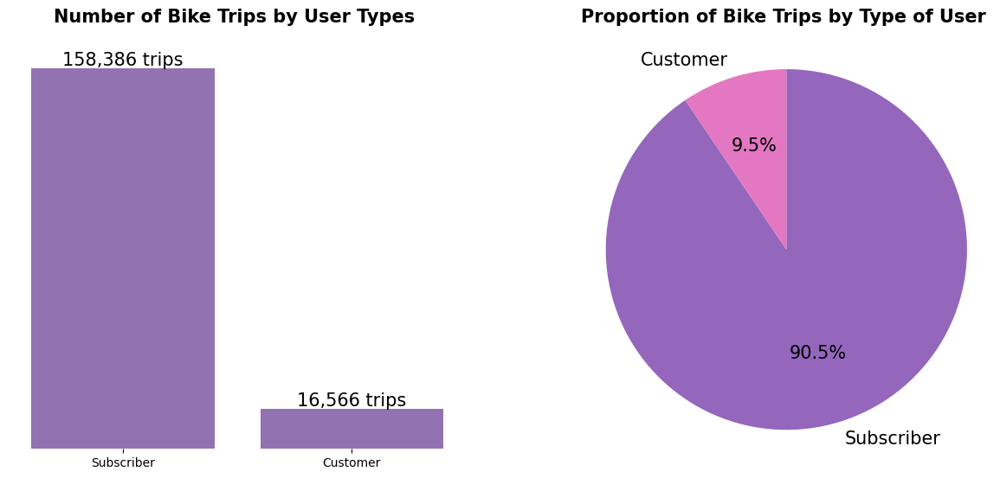

In [38]:
# Resize the chart, and have two plots side-by-side
fig, ax = plt.subplots(ncols=2, figsize=(15,6))

# Return frequency count for each unique value
count = clean_df['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Left Plot
# Plot vertical bar
create_bar(clean_df, 'user_type', order=type_order, ax=ax[0])
add_title('Number of Bike Trips by User Types \n', ax = ax[0])


# Right Plot
# Plot pie
create_pie(count, count.index, ax[1])
add_title('Proportion of Bike Trips by Type of User \n', ax[1])

From the above charts, it is observed that majority of trips were taken by Subscribers. Approximately 1 in every 10 trips, selected at random, is taken by a Customer. I would like to explore the data to understand what features best profile each type of user. So, let's get a general idea of each of our supporting features by looking at their distributions.

I will start with the 'member_gender' variable. 

#### What is the gender distribution of users in the dataset?

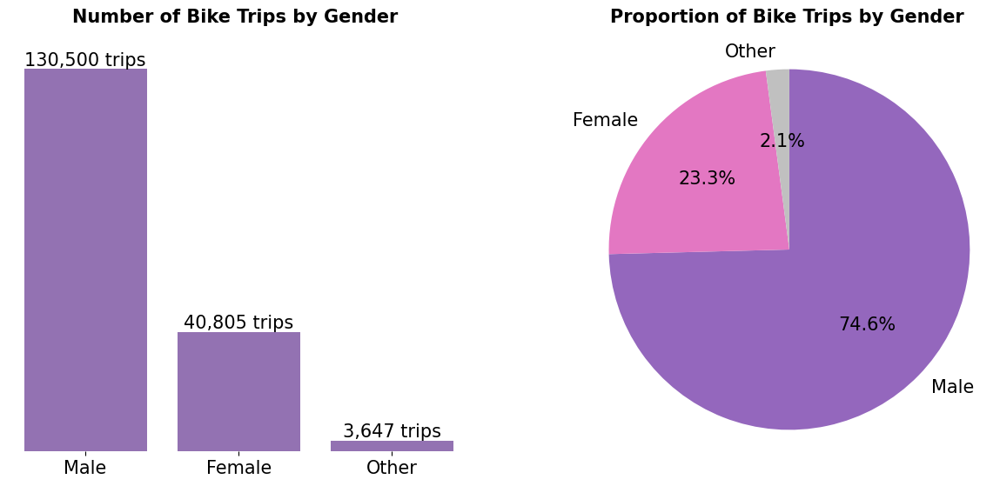

In [39]:
# Resize the chart, and have two plots side-by-side
fig, ax = plt.subplots(ncols=2, figsize=(15,6))

# Return frequency count for each unique value
count = clean_df['member_gender'].value_counts()
# Get ordered index
g_order = count.index

# Left Plot
# Plot vertical bar
create_bar(clean_df, 'member_gender', order=g_order, ax=ax[0])
add_title('Number of Bike Trips by Gender \n', ax[0])


# Right Plot
# Plot pie
create_pie(count, g_order, ax[1])
add_title('Proportion of Bike Trips by Gender \n', ax[1])

It is seen, from the charts above, that majority of bike users are Male. It can also be seen that a small fraction of users in the dataset fall into the Other category i.e. neither Male nor Female. From this insight, I can develop a new question; 'What is the distrubution of gender for each type of user?'. This would help to understand how these genders are distributed based on the 'user_type' variable. 

Now let's look at the 'member_age' feature

#### What is the age distribution of users in the dataset?

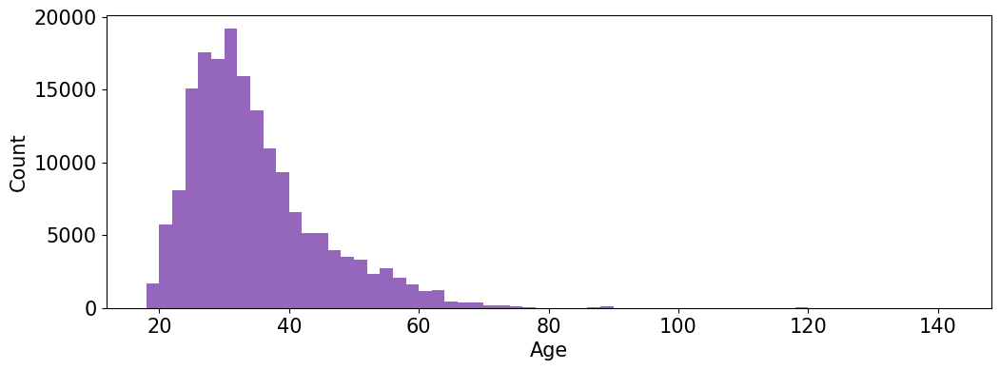

In [40]:
# Set a larger figure size for plot
plt.figure(figsize=(12,4))

# Create bins with step-size 2
max_age = clean_df['member_age'].max()
min_age = clean_df['member_age'].min()
bins = np.arange(min_age, max_age + 2, 2)

# Plot histogram
plt.hist(data=clean_df, x='member_age', color=base_color, bins=bins)

# Format and Label plot
plt.xlabel('Age')
plt.ylabel('Count');

From the above distribution, it is observed that some ages lie above 80. I will treat these ages as outliers and filter them out so as not to skew the analysis.

In [41]:
# Remove trips with age greater than 85
filtered_clean_df = clean_df[clean_df['member_age'] < 85]

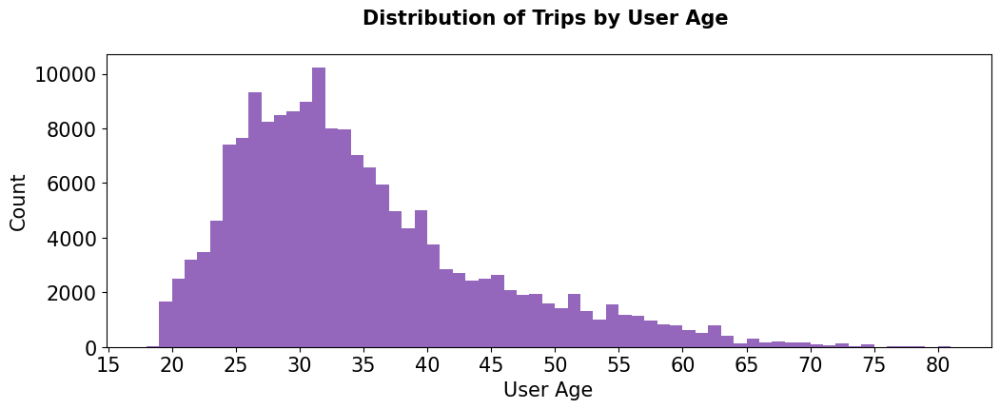

In [42]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(12,4))

# Create bins with step-size 1
max_age = filtered_clean_df['member_age'].max()
min_age = filtered_clean_df['member_age'].min()
bins = np.arange(min_age, max_age + 1, 1)

# Plot histogram
plt.hist(data=clean_df, x='member_age', color=base_color, bins=bins)

# Format and Label plot
plt.xticks(np.arange(15, max_age, 5))
plt.xlabel('User Age')
plt.ylabel('Count');
add_title('Distribution of Trips by User Age \n', ax)

The distribution of age is skewed to the right, with a lot of users around the age range of 25 to 40. The age distribution is bimodal, with a peak between 25 and 30 and another between 30 and 35. Interestingly, after the peaks, the frequency continually drops as the age increases except for slight jumps, but generally still continues on a downward trend. This feature will help to identify the age range inherent to a particular user type.

Now that we've looked at user demographics (i.e. gender and age), let's look at the actual features that define the trips. I will be looking at the 'ride_day' variable first.

#### What day of the week has the highest amount of trips?

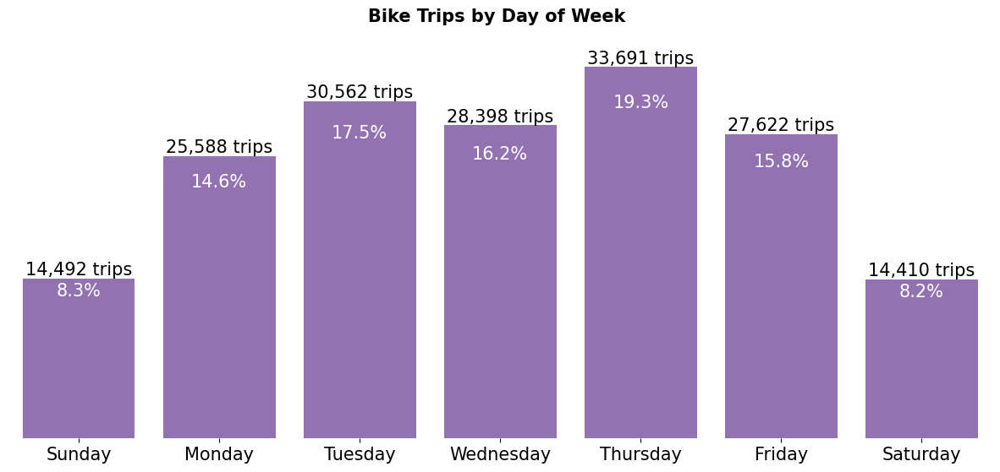

In [43]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(15,6))

# Return frequency count for each unique value
count = filtered_clean_df['ride_day'].value_counts()
n = count.sum()

# Plot vertical bar
create_bar(filtered_clean_df, 'ride_day', order=None, ax=ax)
add_title('Bike Trips by Day of Week \n', ax)

# Format and Label plot
locs, labels = plt.xticks()
for loc, label in zip(locs, labels):
    value = count[label.get_text()]
    pct_string = '{:0.1f}%'.format(100*value/n)
    # print the annotation on bar
    plt.text(loc, value*0.89, pct_string, ha = 'center', color = 'white')

From the chart above, 19% of trips occurred on a Thursday. Also we can see that trips on the weekend, i.e. Saturday and Sunday, have the least frequency. We would be able to better understand the ride habits, in terms of day of the week, for each of the user types by plotting a chart to see the relative frequency of trips for each user type. We would also check if the high value of trips on Thursday as compared to other days are as a result of a holiday. These would be seen later in our bivariate exploration.

Next let's look at the 'start_time_bins' feature.

#### At what time of the day do most users embark on their trips?

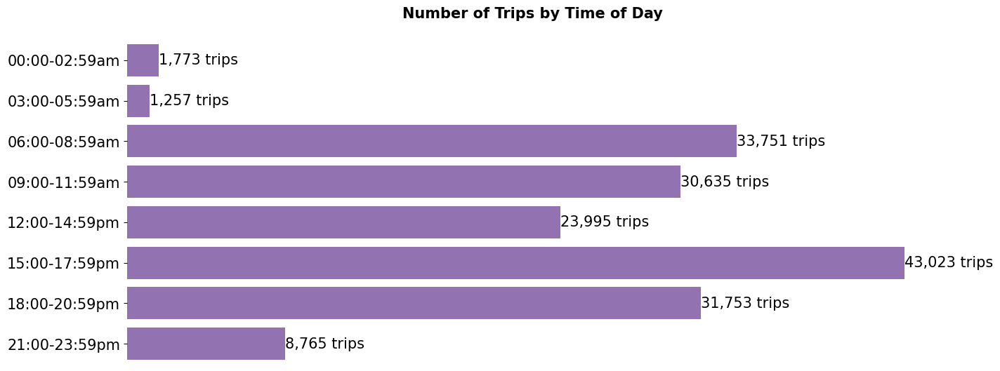

In [44]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(15,6))

# Return frequency count for each unique value
count = clean_df['start_time_bin'].value_counts()

# Plot horizontal bar
create_hbar(clean_df, 'start_time_bin', order=None, ax=ax)
add_title('Number of Trips by Time of Day \n', ax);

From the above chart, We can see that most users embarked on their trips in the afternoon within the time window of 15:00pm to 17:59pm. We can also see that night trips are less frequent. Using this variable we can identify the most common embarkment time window for the different user types. 

Let's look at the 'duration_mins' variable.

#### What is the distribution of trip durations in the dataset?

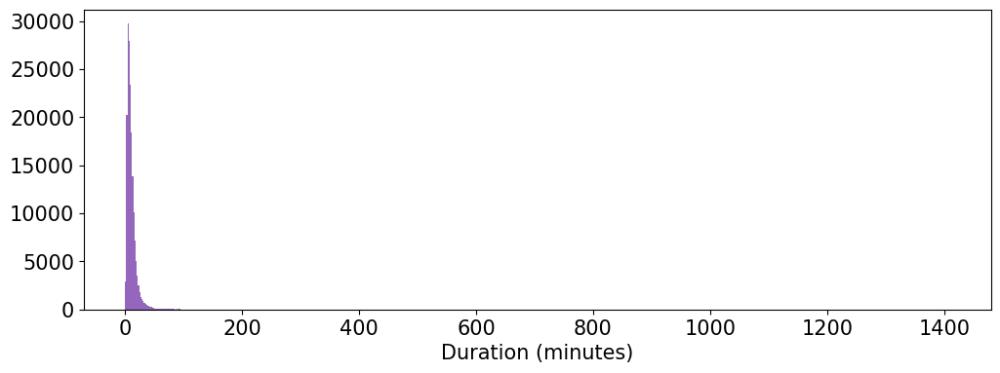

In [45]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(12,4))

# Create bins with step-size 2
max_duration = filtered_clean_df['duration_mins'].max()
bins = np.arange(0, max_duration + 2, 2)

# Plot histogram
plt.hist(data=filtered_clean_df, x='duration_mins', color=base_color, bins=bins)
plt.xlabel('Duration (minutes)');

The Bay Area Bike Share Initiative was designed as a healthy, quick and convenient means of transit for shorter duration trips of 30 minutes or less but trips of 31-60 minutes are allowed at an additional cost [(Wheretraveler.com)](https://www.wheretraveler.com/san-francisco/play/guide-bay-area-bike-share). Therefore, trips exceeding 60 minutes will be filtered out from the data.

In [46]:
# Remove trips with duration greater than 60
filtered_clean_df = filtered_clean_df[filtered_clean_df['duration_mins'] <= 60]

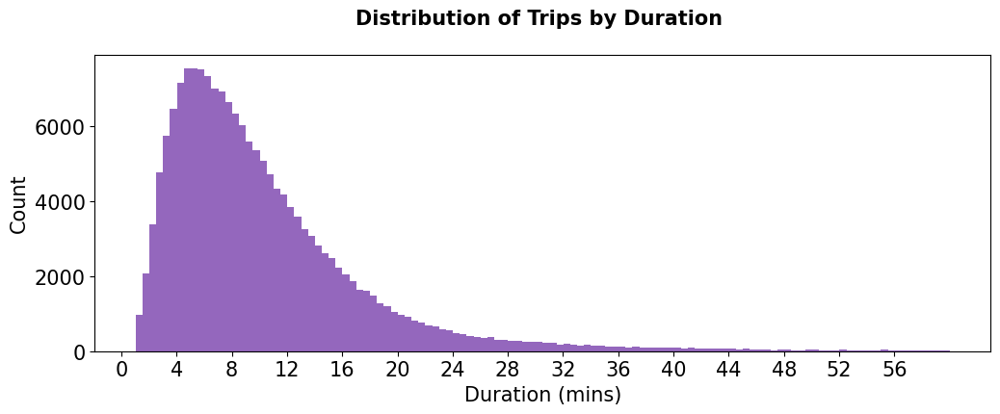

In [47]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(12,4))

# Create bins with step-size 0.5
max_duration = filtered_clean_df['duration_mins'].max()
min_duration = filtered_clean_df['duration_mins'].min()
bins = np.arange(min_duration, max_duration + 0.5, 0.5)

# Plot histogram
plt.hist(data=filtered_clean_df, x='duration_mins', color=base_color, bins=bins)

# Format and Label plot
plt.xticks(np.arange(0, max_duration, 4))
plt.xlabel('Duration (mins)')
plt.ylabel('Count')
add_title('Distribution of Trips by Duration \n', ax)

The duration distribution is right-skewed and has a really long tail. It is observed that majority of trips last between the duration of 4-16 minutes and longer trips are also less frequent. This is in line with the purpose of the bike share system which is for short duration trips.

Now I will take a look at the 'start_station_name' and 'end_station_name' variables.

#### Which station is most popular?

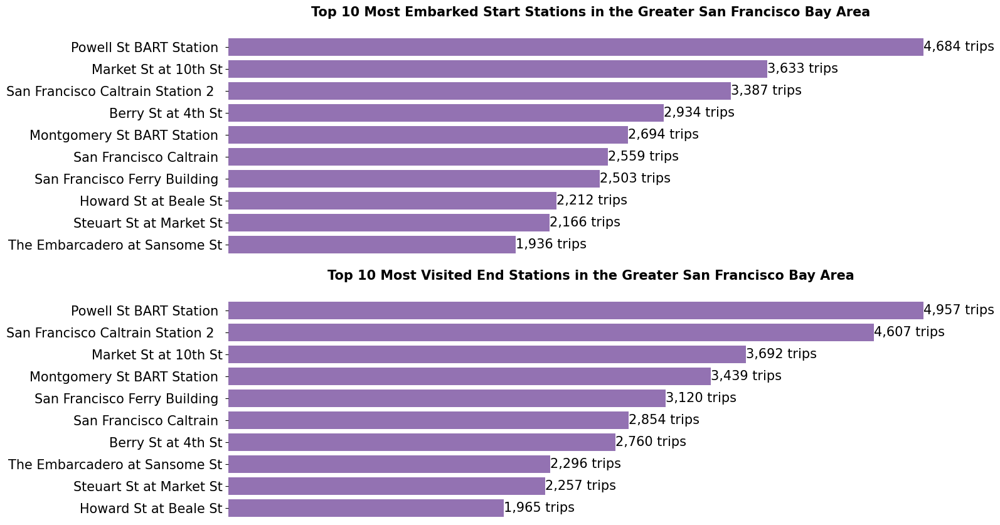

In [48]:
# Create subplots
fig, ax = plt.subplots(nrows=2, figsize=(15,10))

# Top Plot
# Get first 10 start stations in descending order of frequency
count = filtered_clean_df['start_station_name'].value_counts().head(10)
# Get ordered index
station_order = count.index

# Plot horizontal bar
create_hbar(filtered_clean_df, 'start_station_name', station_order, ax=ax[0])
add_title('Top 10 Most Embarked Start Stations in the Greater San Francisco Bay Area \n', ax[0])


# Bottom Plot
# Get first 10 end stations in descending order of frequency
count = filtered_clean_df['end_station_name'].value_counts().head(10)
# Get ordered index
station_order = count.index

# Plot horizontal bar
create_hbar(filtered_clean_df, 'end_station_name', station_order, ax=ax[1])
add_title('Top 10 Most Visited End Stations in the Greater San Francisco Bay Area \n', ax[1])

From the above charts, we can see that the Powell St BART station is the most visited and most popuplar station for bike user trips. We can also see that the top 10 start stations and the top 10 end stations are the same albeit with some fluctuations in position. We will explore which type of user frequents this station in the bivariate exploration section and we can also view the spread of the stations as well.

The last supporting feature I will look at is the 'bike_share_for_all_trip' variable. 

#### What is the proportion of trips made by users with bikeshareforall membership in the dataset?

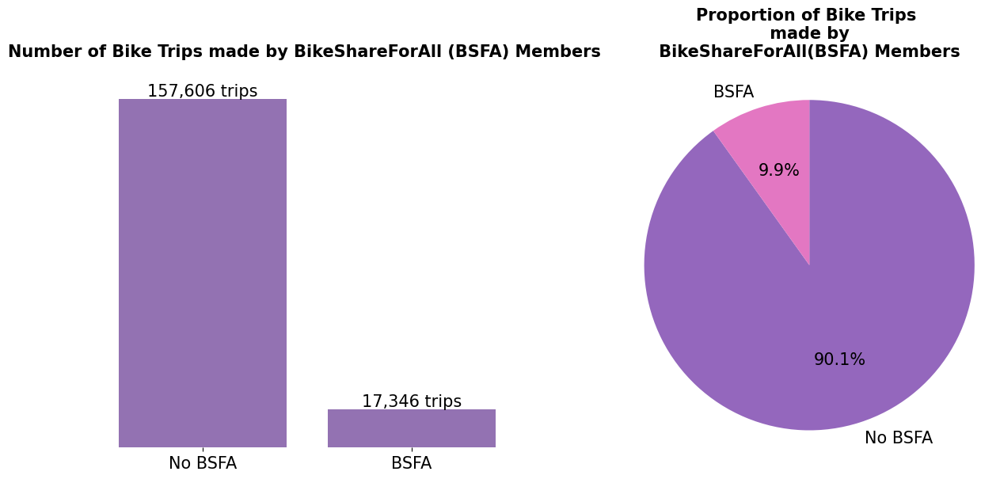

In [49]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(15,6))

# Return frequency count for each unique value
count = filtered_clean_df['bike_share_for_all_trip'].value_counts()

# Left Plot
# Plot vertical bar
create_bar(clean_df, 'bike_share_for_all_trip', order=None, ax=ax[0])
add_title('Number of Bike Trips made by BikeShareForAll (BSFA) Members \n', ax[0])
labels = ['No BSFA', 'BSFA']
ax[0].set_xticks([0, 1], labels);


# Right Plot
# Plot pie
create_pie(count, labels, ax[1])
add_title('Proportion of Bike Trips \n made by \n BikeShareForAll(BSFA) Members \n', ax[1])

BikeshareforAll is a subsidized membership program which makes membership accessible to low-come individuals. It includes trips up to a full hour without redocking [(Sfmta.com)](https://www.sfmta.com/blog/bikeshare-pricing-frequently-asked-questions-faq). From the visuals above, we can see that about 10% of trips were taken by users with the bikeshareforall membership.

### Discuss the distribution(s) of your variable(s) of interest. Were there any unusual points? Did you need to perform any transformations?

From the univariate exploration, I noticed that most trips based on the 'user_type' variable are made by Subscribers. I also noticed, in the case of the 'member_gender' variable, that Males take up about 75% of the data and that the 'ride_day' with the most trips is Thursday. I also saw from the 'start_station_name' and 'end_station_name' variables that the top 10 stations include the same list of stations although their positions change. From the 'bike_share_for_all_trips' variable, I observed that there were very few trips made by users under the program.


### Of the features you investigated, were there any unusual distributions? Did you perform any operations on the data to tidy, adjust, or change the form of the data? If so, why did you do this?
The 'member_age' distribution was largely skewed to the right so I arbitrarily used the age of 80 as the maximum age since I saw that a lot of values were gathered around values below 80. I also performed an adjustment to the 'duration_mins' variable by filtering out trips that took longer than 60 minutes. Before i did this I researched about bike share systems in San Francisco and found out that they were designed for shorter duration trips. From [(Wheretraveler.com)](https://www.wheretraveler.com/san-francisco/play/guide-bay-area-bike-share), I saw that trips of 31-60 minutes are allowed but at an additional cost so I filtered the data based on that info.

<a id='bi'></a>
### <u>Bivariate Exploration</u>

This aspect of exploration investigates the relationships between pairs of variables. 

In [50]:
def create_clusteredbar(data, x, y, hue, hue_order, order, legend_title, ax): # Function creates a vertical clustered bar chart on a specified axis object
    plt.rc('font', size=fontsize)
    sns.set_context(rc={'patch.linewidth':0.0})
    sns.countplot(data=data, 
                  x=x, 
                  y=y,
                  hue=hue, 
                  palette=  {hue_order[0]:base_color, hue_order[1]:next_color}, 
                  hue_order=hue_order, 
                  order=order, 
                  ax=ax
                 )
    ax.set(xlabel=None, ylabel=None)
    ax.spines[['top', 'bottom', 'right', 'left']].set_visible(False)
    ax.legend(title=legend_title);

def create_heat(data, xlabel, ylabel, ax, cbarlabel, vmin): # Function creates a 2d bar chart on a specified axis object
    sns.heatmap(data, annot=True, fmt='.0f', vmin=vmin, ax=ax, cmap='BuPu', cbar_kws={'label':cbarlabel})
    ax.set(xlabel=xlabel, ylabel=ylabel);

To start off, we would look at the relationships between our supporting features.

Let's check the effect our two numerical variables; 'member_age', 'duration_mins', have on our four supporting categorical variables.

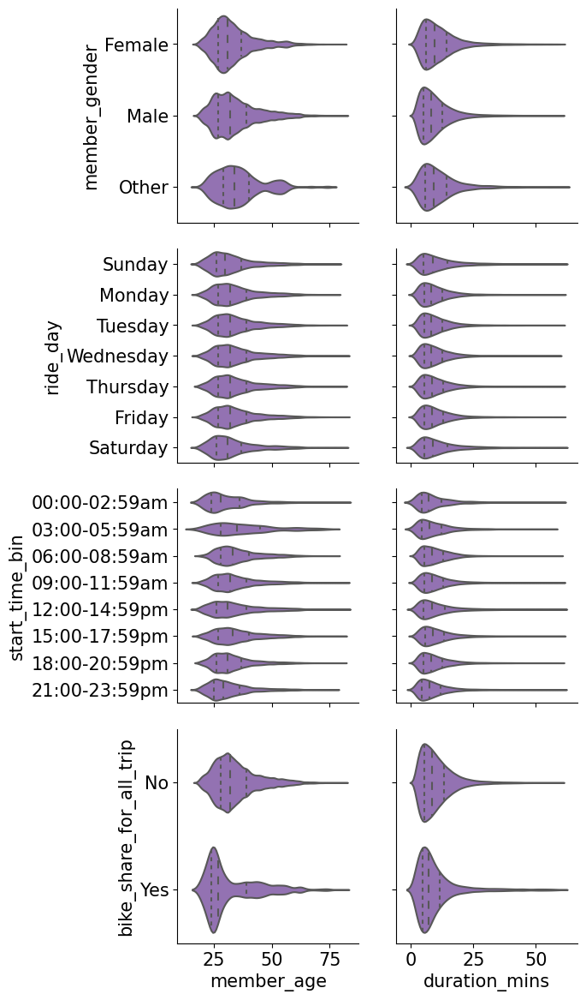

In [51]:
# plot matrix of numeric features against categorical features.
g = sns.PairGrid(data=filtered_clean_df, 
                 y_vars=['member_gender', 'ride_day','start_time_bin', 'bike_share_for_all_trip'],
                 x_vars=['member_age', 'duration_mins'], height=3)
g.map(sns.violinplot, inner='quartile', color=base_color);

From the above, we see that the distributions of the two numerical variables on the categorical variables of interest are majorly skewed to the right. In the case of 'bike_share_for_all_trip', we can see that the age range of users with bikeshareforall membership are larger than those without it and we can also see that the users who are not bikeshareforall members tend to be older than those who are. 

Also, we can observe from the 'user_type' variable that age has no relationship but has a cluster which may help to develop profiles for our user types. We can also see that Subscribers tend to take shorter trips than Customers. There is no obvious relationship between the two numerical variables and the categorical variables except in the case of the 'bike_share_for_all_trip' and our main variable of interest; 'user_type'. Regardless, all the variables of interest can aid in our investigation by highlighing key insights regarding user-type personas.

Now I will look at the relationship between our two supporting numerical variables

In [52]:
# Correlation coefficient: Age and Duration
filtered_clean_df['member_age'].corr(filtered_clean_df['duration_mins'])

0.026492874651293293

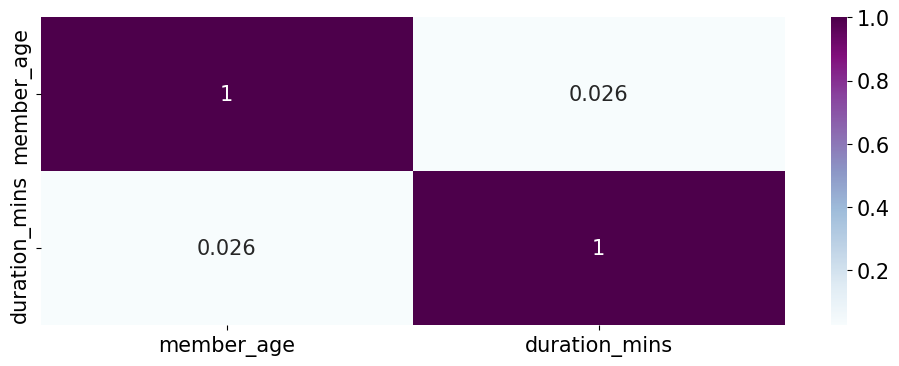

In [53]:
# Set a larger figure size for plot
fig, ax = plt.subplots( figsize=(12,4))

# correlation plot
numeric_vars = filtered_clean_df[['member_age', 'duration_mins']]
corr = numeric_vars.corr(method="pearson")
sns.heatmap(corr, cmap='BuPu', annot=True);

From the correlation heatmap above, the 'member_age' and 'duration_mins' variables have a very weak positive correlation. There's almost no relationship between them. Let's look at the scatterplot of these variables.

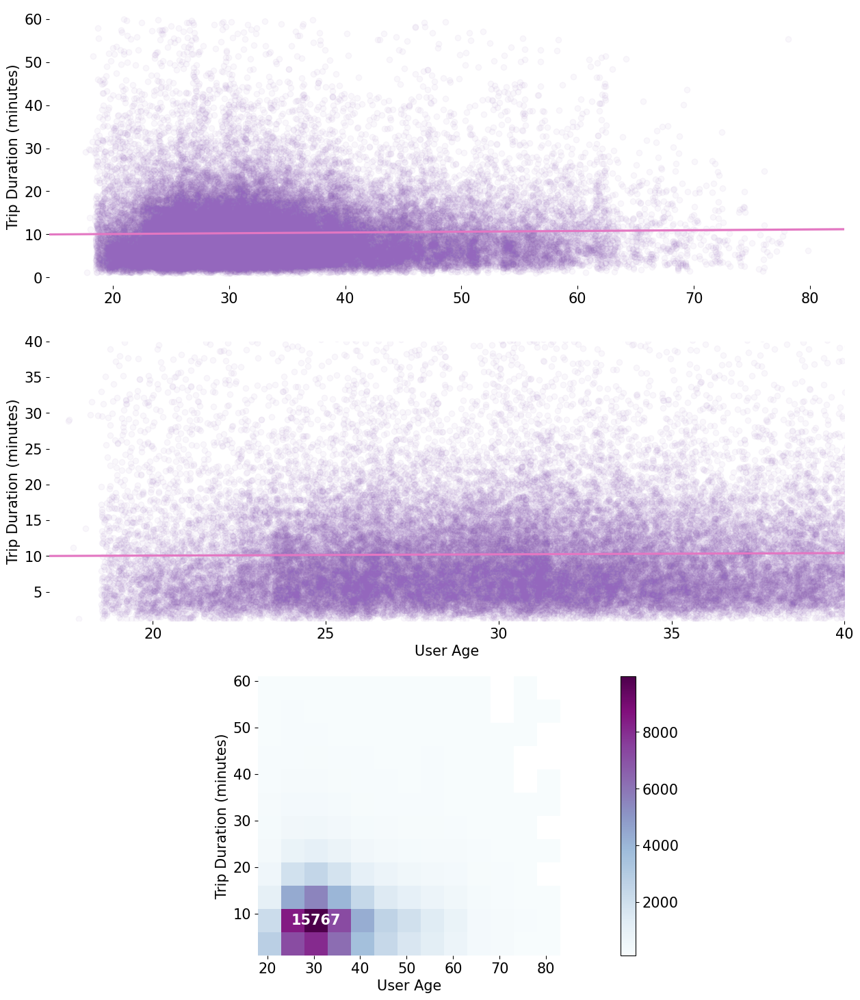

In [54]:
# Import necessary packages
from mpl_toolkits.axes_grid1 import make_axes_locatable

# Create subplots
fig, ax = plt.subplots(nrows=3, figsize=(15,18))

# Create sample of 30% of the data
sample = filtered_clean_df.sample(frac=0.3, random_state=1)

# Top Plot
# Create scatterplot
sns.regplot(data=sample, x='member_age', y='duration_mins',
            truncate=False, x_jitter=0.5,
            scatter_kws={'color':base_color, 'alpha':0.05},
            line_kws={'color':next_color},
            ax=ax[0]
           )
ax[0].set(xlabel=None, ylabel='Trip Duration (minutes)')
ax[0].spines[['top', 'bottom', 'right', 'left']].set_visible(False);


# Middle Plot
# Create scatterplot
sns.regplot(data=sample, x='member_age', y='duration_mins',
            truncate=False, x_jitter=0.5,
            scatter_kws={'color':base_color, 'alpha':0.05},
            line_kws={'color':next_color},
            ax=ax[1]
           )
ax[1].set(xlabel='User Age', ylabel='Trip Duration (minutes)', ylim=(1,40), xlim=(17,40))
ax[1].spines[['top', 'bottom', 'right', 'left']].set_visible(False);


# Bottom Plot
# Create bins with step-size 5
bin_x = np.arange(18, 80+5, 5)
bin_y = np.arange(1, 60+5, 5)

# Plot 2d histogram
hd = ax[2].hist2d(data=filtered_clean_df, x='member_age', y='duration_mins', cmin=0.5, cmap='BuPu', bins=[bin_x, bin_y])

# Add colorbar
divider = make_axes_locatable(ax[2])
cax= divider.append_axes('right', size='5%')
img = np.random.randint(0, 10000, (10, 10))
im = ax[2].imshow(img, cmap='BuPu')
fig.colorbar(im, cax=cax, orientation='vertical')

# Format and label plot
ax[2].set(xlabel='User Age', ylabel='Trip Duration (minutes)')
ax[2].spines[['top', 'bottom', 'right', 'left']].set_visible(False);

# Add annotation showing largest value 
counts = hd[0]
ax[2].text(bin_x[2]+2.5, bin_y[1]+2.5, int(counts[2,1]), ha = 'center', va = 'center', color = 'white', fontweight='bold');

From the above plots we can see that although the two variables have a very weak correlation, the scatterplot shows a cluster of values around shorter trip durations from below 15 minutes and the age range of 25-35. This shows that the two variables may be able aid in our investigation and development of our user type personas.

Let's also look at the relationships between our categorical supporting features.

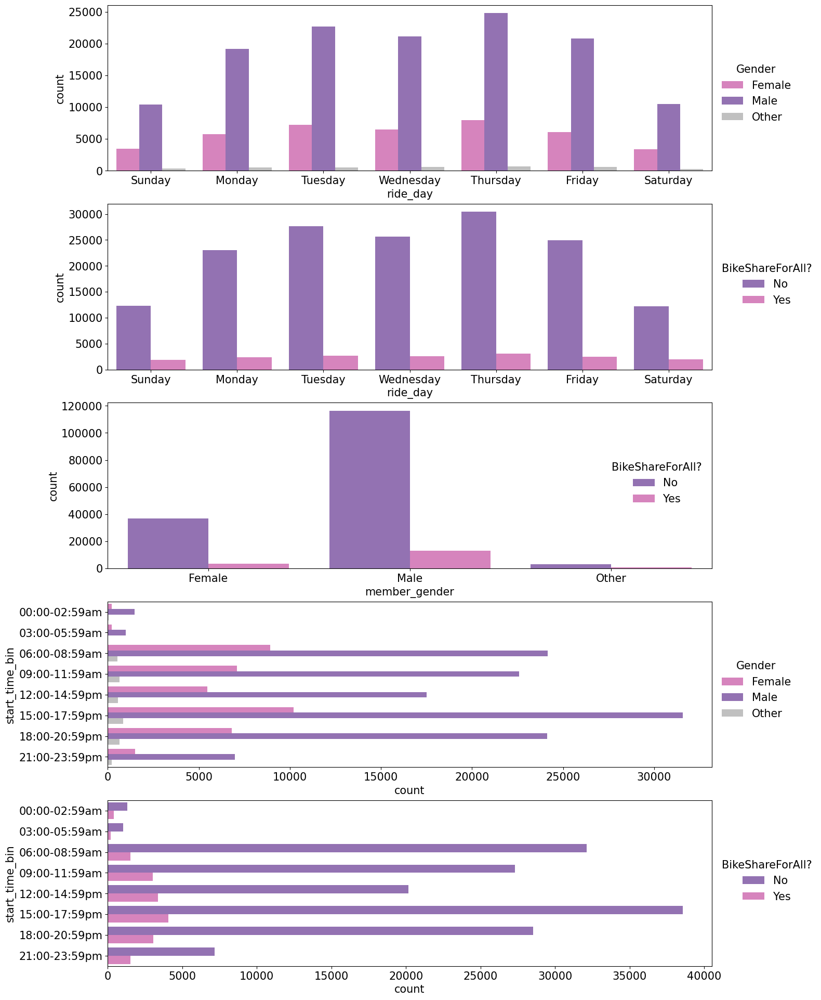

In [55]:
# Create subplots
fig, ax = plt.subplots(nrows=5, figsize=(15,24))

# Day of week v Gender
# Create clustered bar
sns.countplot(data=filtered_clean_df,  x='ride_day', hue='member_gender', palette={'Male':base_color, 'Female':next_color, 'Other':'silver'}, ax=ax[0])
ax[0].legend(bbox_to_anchor=(1,0.7), title='Gender')


# Day of Week v bike_share_for_all_trip
# Create clustered bar
sns.countplot(data=filtered_clean_df,  x='ride_day', hue='bike_share_for_all_trip', palette={'No':base_color, 'Yes':next_color}, ax=ax[1])
ax[1].legend(bbox_to_anchor=(1,0.7), title=('BikeShareForAll?'))


# Gender v bike_share_for_all_trip
# Create clustered bar
sns.countplot(data=filtered_clean_df,  x='member_gender', hue='bike_share_for_all_trip', palette={'No':base_color, 'Yes':next_color}, ax=ax[2])
ax[2].legend(bbox_to_anchor=(1,0.7), title=('BikeShareForAll?'))


# Start time bin v Gender
# Create clustered bar
sns.countplot(data=filtered_clean_df,  y='start_time_bin', hue='member_gender', palette={'Male':base_color, 'Female':next_color, 'Other':'silver'}, ax=ax[3])
ax[3].legend(bbox_to_anchor=(1,0.7), title='Gender');


# Start time bin v bike_share_for_all_trip
# Create clustered bar
sns.countplot(data=filtered_clean_df,  y='start_time_bin', hue='bike_share_for_all_trip', palette={'No':base_color, 'Yes':next_color}, ax=ax[4])
ax[4].legend(bbox_to_anchor=(1,0.7), title=('BikeShareForAll?'));

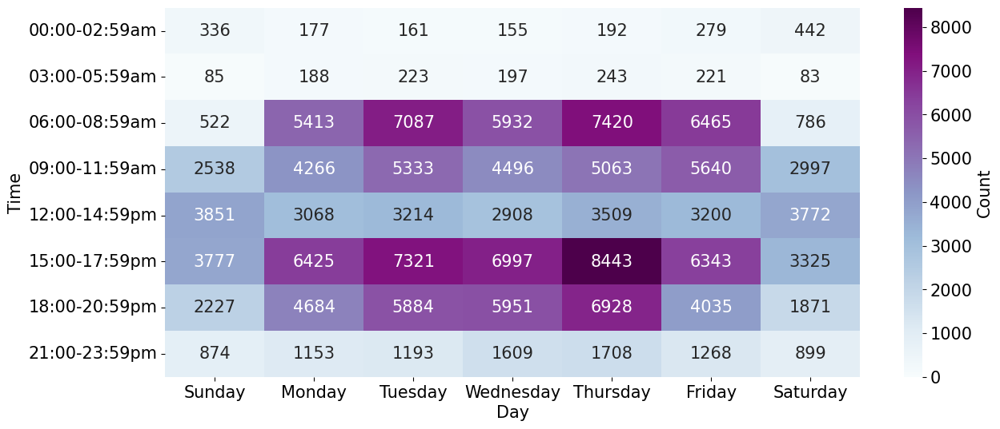

In [56]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(14,6))

# Get data to plot 2d bar chart
sharedtype_table= pd.pivot(filtered_clean_df.groupby(['ride_day', 'start_time_bin']).size().reset_index(),
                           index='start_time_bin', 
                           columns='ride_day', 
                           values=0)

# Plot 2d bar chart
create_heat(sharedtype_table, 'Day', 'Time', ax, 'Count', vmin=0)
plt.xticks(rotation=0);

We can see that our supporting categorical variables majorly show clusters in the data. It will be interesting to see how all the supporting features interplay with each other when the main feature is added. This will be seen in the multivariate exploration section.

We will now look at our main feature of interest; 'user_type', against other features which we feel will aid in our investigation

#### What is the distrubution of gender for each type of user?

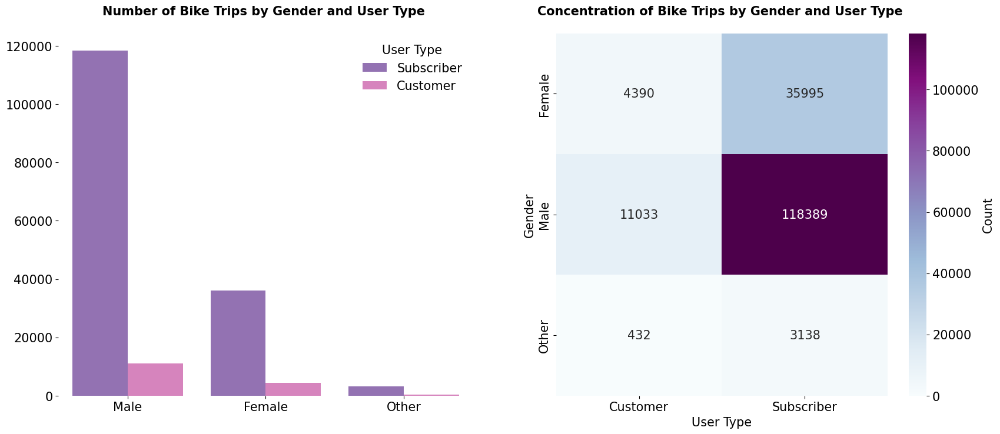

In [57]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(20,8))

# Return frequency count for each unique value
count = filtered_clean_df['member_gender'].value_counts()
# Get ordered index
g_order = count.index

# Return frequency count for each unique value
count = filtered_clean_df['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Create clustered bar
create_clusteredbar(filtered_clean_df, 'member_gender', None, 'user_type', type_order, g_order, 'User Type', ax[0])
add_title('Number of Bike Trips by Gender and User Type \n', ax[0])


# Get data to plot 2d bar chart
gt_table= pd.pivot(filtered_clean_df.groupby(['member_gender', 'user_type']).size().reset_index(),
                   index='member_gender', 
                   columns='user_type', 
                   values=0)

# Plot 2d bar chart
create_heat(gt_table, 'User Type', 'Gender', ax[1], 'Count', vmin=0)
add_title('Concentration of Bike Trips by Gender and User Type \n', ax[1])

As we have established in the univariate section that Subscribers occupy majority of the San Francisco Bay bikeshare trip data, It is understandable that the count of Male Users for Subscribers exceed that of Customers. Regardless, we can see that for both user types, Males exceed Females. 

#### How are user types shared across days of the week? What is the peak day for trips for each user type?

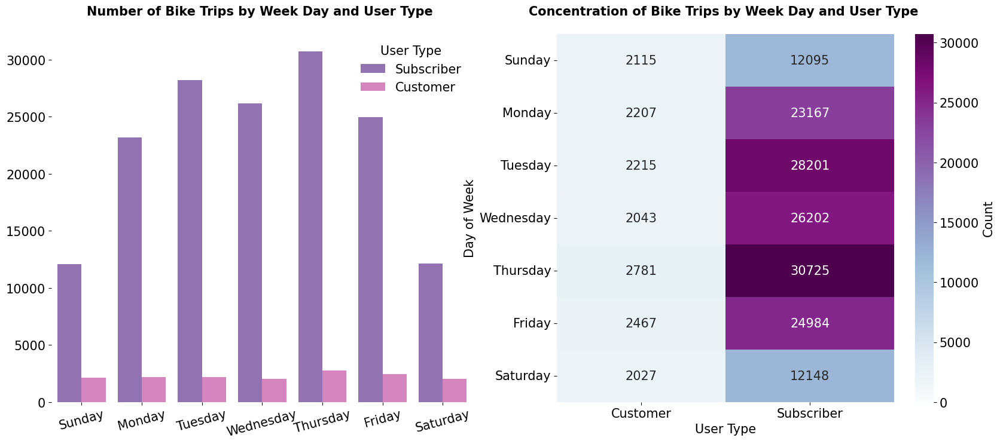

In [58]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(20,8))

# Return frequency count for each unique value
count = filtered_clean_df['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Create clustered bar
create_clusteredbar(filtered_clean_df, 'ride_day', None, 'user_type', type_order, None, 'User Type', ax[0])
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=15);
add_title('Number of Bike Trips by Week Day and User Type \n', ax[0])


# Get data to plot 2d bar chart
daytype_table= pd.pivot(filtered_clean_df.groupby(['ride_day', 'user_type']).size().reset_index(),
                   index='ride_day', 
                   columns='user_type', 
                   values=0)

# Plot 2d bar chart
create_heat(daytype_table, 'User Type', 'Day of Week', ax[1], 'Count', vmin=0)
add_title('Concentration of Bike Trips by Week Day and User Type \n', ax[1])

For both user types, we can see that the day with the peak number of trips is Thursday. As stated in our univariate exploration section, this could be as a result of a holiday so let's check if the high value of trips on Thursday, as compared to other days, is as a result of a holiday.

#### Was the gap between Thursday and other days due to a holiday?

In [59]:
! pip install holidays

In [60]:
# Import necessary packages
import holidays
sfb = holidays.US()
sfb.append({'2019-02-14': 'Valentines Day'})

index = list(filtered_clean_df.index) #  List of row indexes for bike user data

# Create new column with boolean value to check if day is holiday or not
for i in index: 
    filtered_clean_df.loc[i, 'is_holiday'] = filtered_clean_df['start_date'][i] in sfb

In [61]:
# Check unique values in column
filtered_clean_df['is_holiday'].unique()

array([False, True], dtype=object)

In [62]:
# Return frequency count for each unique value
filtered_clean_df['is_holiday'].value_counts()

False    161889
True      11488
Name: is_holiday, dtype: int64

In [63]:
# Remove trips made on holidays from the data
no_holiday = filtered_clean_df[filtered_clean_df['is_holiday'] == False]

In [64]:
# Groupby 'ride_day' by 'is_holiday' and return frequency count for each unique value
filtered_clean_df.groupby('is_holiday')['ride_day'].value_counts()

is_holiday           
False       Tuesday      30416
            Wednesday    28245
            Friday       27451
            Thursday     27199
            Monday       20193
            Sunday       14210
            Saturday     14175
True        Thursday      6307
            Monday        5181
            Sunday           0
            Tuesday          0
            Wednesday        0
            Friday           0
            Saturday         0
Name: ride_day, dtype: int64

From the above, we can see that holidays fell only on Monday and Thursday. The two holidays celebrated in San Francisco in the month of February are Presidents' Day which is on the third Monday of month [(Sanfrancisco.net)](https://www.sanfrancisco.net/public-holidays) and Valentines Day which is on the 14th.

In [65]:
# Get holiday that falls on Thursday and show what the holiday is
mask = (filtered_clean_df['is_holiday'] == True) & (filtered_clean_df['ride_day'] == 'Thursday')
thurs_hols = filtered_clean_df[['start_date', 'ride_day', 'is_holiday']][mask]
hol_date = thurs_hols['start_date'].unique()
for i in hol_date:
    holiday = sfb.get(str(i))
    print(f'{str(i)} falls on a Thursday and it is {holiday}.')

2019-02-14T00:00:00.000000000 falls on a Thursday and it is Valentines Day.


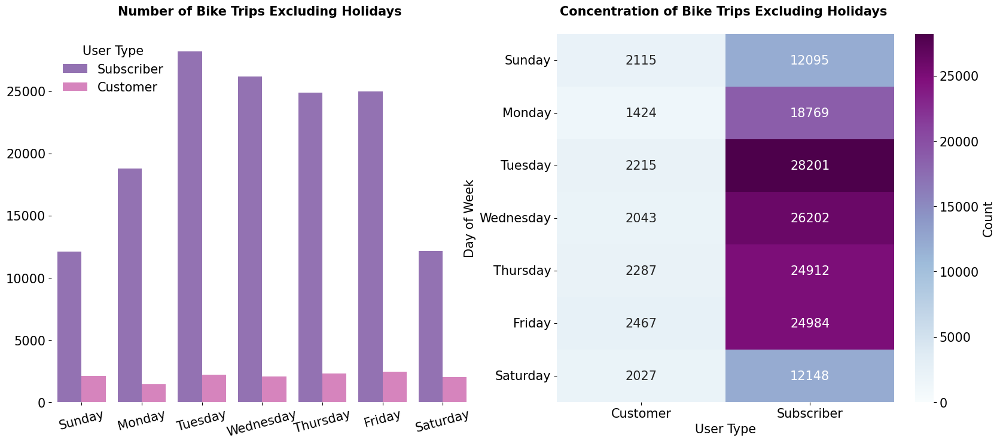

In [66]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(20,8))

# Return frequency count for each unique value
count = no_holiday['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Create clustered bar
create_clusteredbar(no_holiday, 'ride_day', None, 'user_type', type_order, None, 'User Type', ax[0])
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=15);
add_title('Number of Bike Trips Excluding Holidays \n', ax[0])


# Get data to plot 2d bar chart
daytype_table= pd.pivot(no_holiday.groupby(['ride_day', 'user_type']).size().reset_index(),
                   index='ride_day', 
                   columns='user_type', 
                   values=0)

# Plot 2d bar chart
create_heat(daytype_table, 'User Type', 'Day of Week', ax[1], 'Count', vmin=0)
add_title('Concentration of Bike Trips Excluding Holidays \n', ax[1])

After visualizing the data again without the holidays, It is seen that Tuesday becomes the day with the highest trip activity for Subscribers while Friday has the highest trip activity for Customers. Hence, the increased ride activity on Thursday as compared to other days of the week is affected by the observance of the Valentine's Day holiday. 

#### How are the user types shared across different times in a day? What is the peak time for trips for each user type?

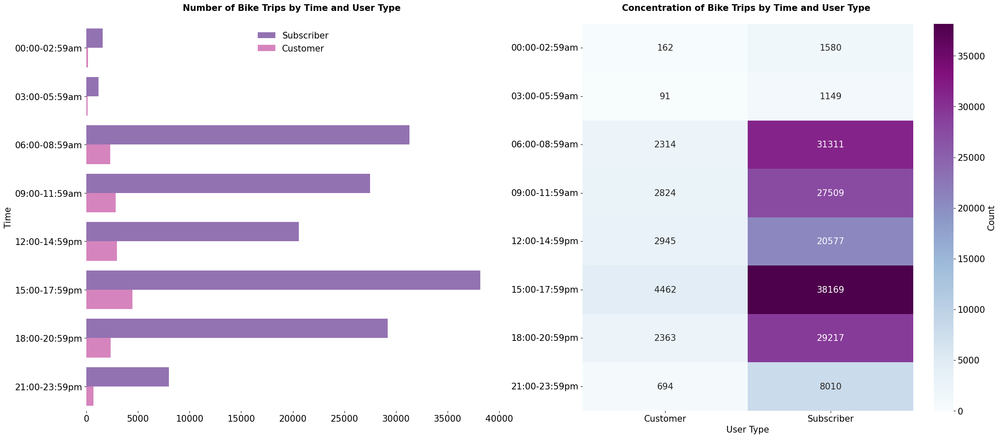

In [67]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(28, 12))

# Return frequency count for each unique value
count = filtered_clean_df['start_time_bin'].value_counts()

# Return frequency count for each unique value
count = filtered_clean_df['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Create clustered bar
create_clusteredbar(filtered_clean_df, None, 'start_time_bin', 'user_type', type_order, None, 'User Type', ax[0])
ax[0].set(ylabel='Time')
ax[0].legend(loc=9);
add_title('Number of Bike Trips by Time and User Type \n', ax[0])


# Get data to plot 2d bar chart
timetype_table= pd.pivot(filtered_clean_df.groupby(['start_time_bin', 'user_type']).size().reset_index(),
                   index='start_time_bin', 
                   columns='user_type', 
                   values=0)

# Plot 2d bar chart
create_heat(timetype_table, 'User Type', None, ax[1], 'Count', vmin=0)
add_title('Concentration of Bike Trips by Time and User Type \n', ax[1])

From the charts above, we can see that the peak time for both types of user is the same. Customers and Subscribers mostly take trips between 15:00pm and 17:59pm. Let's see if this would change when we exclude trips on holidays. 

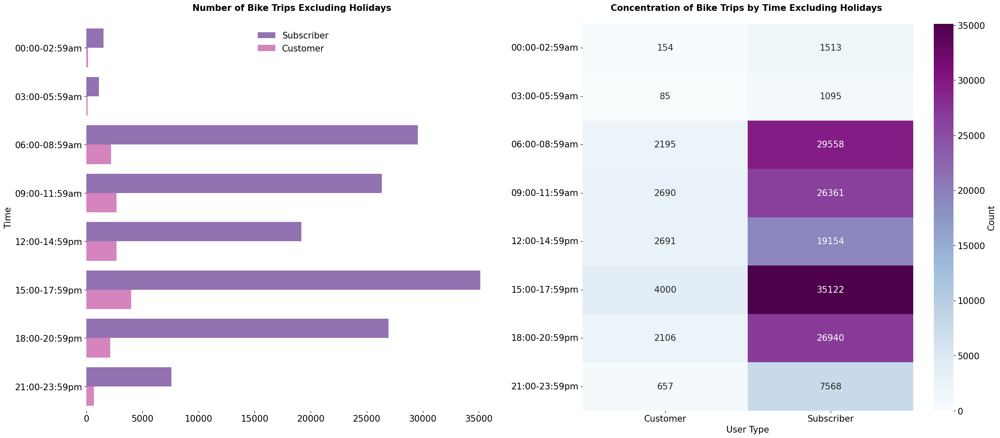

In [68]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(28,12))

# Return frequency count for each unique value
count = no_holiday['start_time_bin'].value_counts()

# Return frequency count for each unique value
count = no_holiday['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Create clustered bar
create_clusteredbar(no_holiday, None, 'start_time_bin', 'user_type', type_order, None, 'User Type', ax[0])
ax[0].set(ylabel='Time')
ax[0].legend(loc=9);
add_title('Number of Bike Trips Excluding Holidays \n', ax[0])


# Get data to plot 2d bar chart
timetype_table= pd.pivot(no_holiday.groupby(['start_time_bin', 'user_type']).size().reset_index(),
                   index='start_time_bin', 
                   columns='user_type', 
                   values=0)

# Plot 2d bar chart
create_heat(timetype_table, 'User Type', None, ax[1], 'Count', vmin=0)
add_title('Concentration of Bike Trips by Time Excluding Holidays \n', ax[1])

The peak time window for both user types still remains the same. We can say that both Customers and Subscribers usually embark on their trips between the time; 15:00pm and 17:59pm but it's better to drill down to get a more specific outlook. So let's look at the exact hour of day for each user type.

In [69]:
# ignore chained assignment warning
pd.set_option('mode.chained_assignment',None)

# Create new start_hour column
index = no_holiday.index
no_holiday.loc[index, ('start_hour')] = no_holiday.loc[index, 'start_time'].astype(str).str.split(':', expand=True)[0]

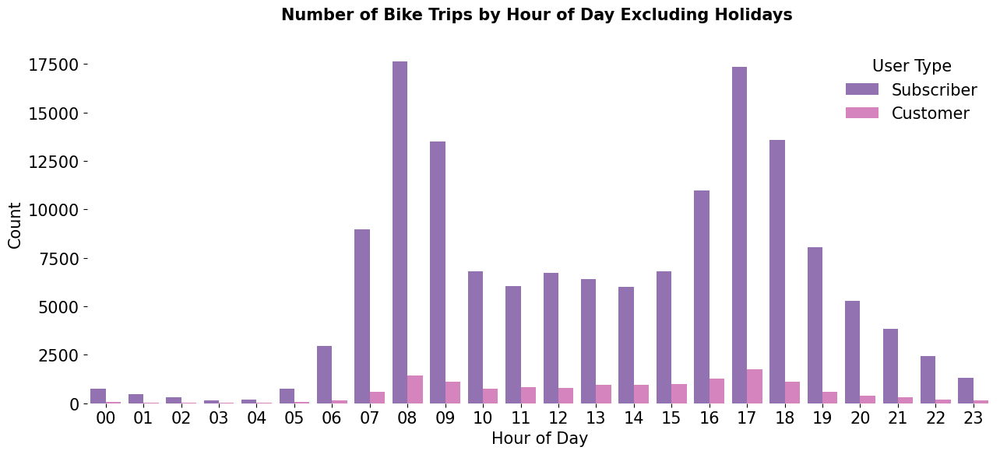

In [70]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(15,6))

# Groupby 'ride_day' by 'is_holiday' and return frequency count for each unique value
hour_order = no_holiday.groupby('start_hour')['user_type'].size()
# Get ordered index
hour_order = hour_order.index

# Create clustered bar
create_clusteredbar(no_holiday, 'start_hour', None, 'user_type', type_order, hour_order, 'User Type', ax=ax)
ax.set(xlabel='Hour of Day', ylabel='Count')
add_title('Number of Bike Trips by Hour of Day Excluding Holidays \n', ax)

Looking at the chart above, we can see that the Subscribers took trips mostly at 08:00(8am). This is different from what we saw when we analyzed the data based on time bins of 4 hours. We can also see that Customers took trips mostly at 17:00 (5pm) which is within the time bin of 15:00-17:59pm. Hence, the hour of day does better in identifying when trips are mostly embarked for each user type. We will be using the new dataset with no holidays from here on.

#### What is the proportion of users with the bikeshare for all membership based on user type? 

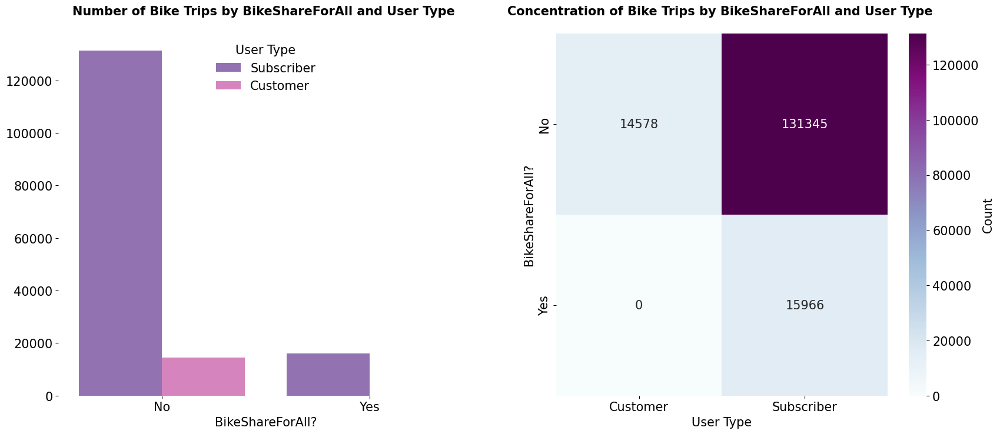

In [71]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(20,8))

# Return frequency count for each unique value
count = no_holiday['bike_share_for_all_trip'].value_counts()
# Get ordered index
shared_order = count.index

# Return frequency count for each unique value
count = no_holiday['user_type'].value_counts()
# Get ordered index
type_order = count.index

# Create clustered bar
create_clusteredbar(no_holiday, 'bike_share_for_all_trip', None, 'user_type', type_order, shared_order, 'User Type', ax[0])
ax[0].set(xlabel='BikeShareForAll?')
add_title('Number of Bike Trips by BikeShareForAll and User Type \n', ax[0])


# Get data to plot 2d bar chart
sharedtype_table= pd.pivot(no_holiday.groupby(['bike_share_for_all_trip', 'user_type']).size().reset_index(),
                   index='bike_share_for_all_trip', 
                   columns='user_type', 
                   values=0)

# Plot 2d bar chart
create_heat(sharedtype_table, 'User Type', 'BikeShareForAll?', ax[1], 'Count', vmin=0)
add_title('Concentration of Bike Trips by BikeShareForAll and User Type \n', ax[1])

It is observed that there are only Subscribers with the bikeshareforall membership. Customers appear to not be enrolled in the bikeshareforall program, presumably due to the fact that they are visitors and not residents or commuters in the area. We discussed about what bikeshareforall is in our univariate exploration; a subsidized membership program which makes membership accessible to low-come individuals. We will explore whether the average duration of trips by users under the bikeshareforall program is the same as that of those who aren't under the program in the multivariate section.

Now let's look at the trip duration for each user type.

#### What is the range of trip duration for each user type?

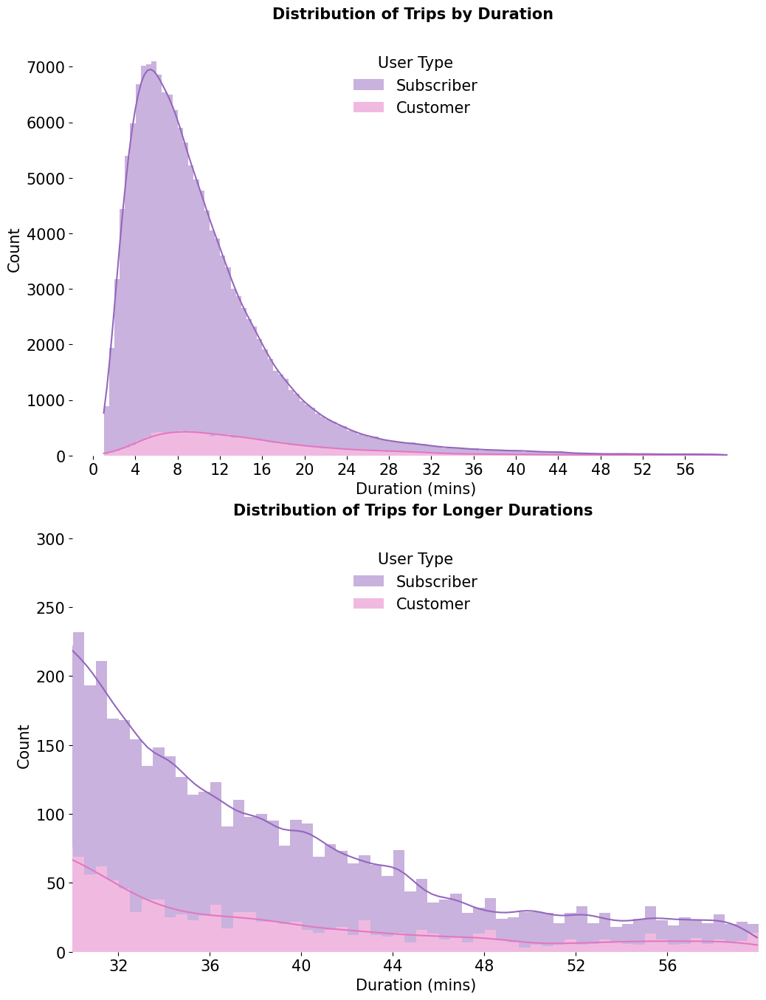

In [72]:
# Create subplots
fig, ax = plt.subplots(nrows=2, figsize=(12,16))

# Create bins with step-size 0.5
max_duration = no_holiday['duration_mins'].max()
min_duration = no_holiday['duration_mins'].min()
bins = np.arange(min_duration, max_duration + 0.5, 0.5)

# Top plot
# Plot histogram
sns.histplot(data=no_holiday, x='duration_mins',
             hue='user_type', hue_order=type_order,
             palette={type_order[0]:base_color, type_order[1]:next_color},
             bins=bins, multiple='stack',
             kde=True, alpha=0.5, ax=ax[0]
            )

# Format amd label plot
ax[0].set(xlabel='Duration (mins)', xticks=np.arange(0, max_duration, 4), ylabel='Count')
ax[0].spines[['top', 'bottom', 'right', 'left']].set_visible(False)
legend = ax[0].get_legend()
handles = legend.legendHandles
legend.remove()
ax[0].legend(handles, ['Subscriber', 'Customer'], title='User Type', loc=9)
add_title('Distribution of Trips by Duration \n', ax[0])


# Bottom Plot
# Plot histogram
sns.histplot(data=no_holiday, x='duration_mins',
             hue='user_type', hue_order=type_order,
             palette={type_order[0]:base_color, type_order[1]:next_color},
             bins=bins, multiple='stack',
             kde=True, alpha=0.5, ax=ax[1]
            )

# Format amd label plot
ax[1].set(xlabel='Duration (mins)', xticks=np.arange(0, max_duration, 4), ylabel='Count', xlim=(30,60),ylim=(0,300))
ax[1].spines[['top', 'bottom', 'right', 'left']].set_visible(False)
legend = ax[1].get_legend()
handles = legend.legendHandles
legend.remove()
ax[1].legend(handles, ['Subscriber', 'Customer'], title='User Type', loc=9)
add_title('Distribution of Trips for Longer Durations \n', ax[1])

The distribution of duration for Subscribers and Customers in the top plot are both skewed to the right although that of subscribers has a more visible peak. Just as discovered in our univariate analysis, majority of trips for Subscribers falls between 4-10 minutes while that of Customers is 4-16 minutes. Also in the bottom plot, It is observed that the number of trips reduces for both Subscribers and Customers as duration increases.

#### What age range has the highest trip frequency for each user type?

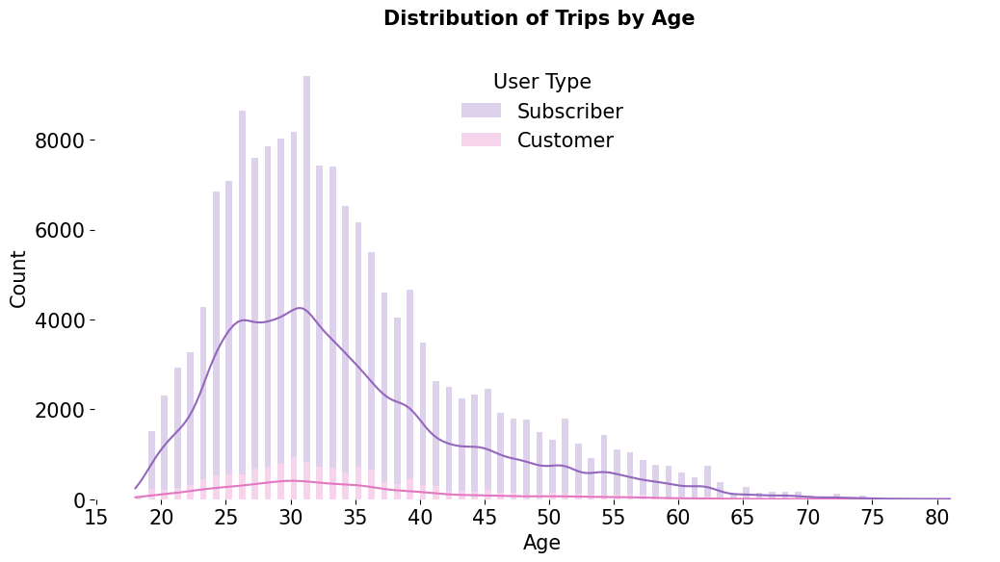

In [73]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(12,6))

# Create bins with step-size 0.5
max_age = no_holiday['member_age'].max()
min_age = no_holiday['member_age'].min()
bins = np.arange(min_age, max_age + 0.5, 0.5)

# Plot histogram
sns.histplot(data=no_holiday, x='member_age',
             hue='user_type', hue_order=type_order,
             palette={type_order[0]:base_color, type_order[1]:next_color},
             bins=bins, multiple='stack',
             kde=True, alpha=0.3, ax=ax
            )

# Format amd label plot
ax.set(xlabel='Age', xticks=np.arange(15, max_age, 5), ylabel='Count')
ax.spines[['top', 'bottom', 'right', 'left']].set_visible(False)
legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
ax.legend(handles, ['Subscriber', 'Customer'], title='User Type', loc=9)
add_title('Distribution of Trips by Age \n', ax)

The distribution of age for Subscribers is bimodal while that of Customers is unimodal. Majority of trips by both Subscribers and Customers were taken by users within the age range of 25 to 35. Subscribers aged 26 and 31 made the most trips with age 31 having the largest frequency. Thus, the majority of Subscriber trips tend to be taken by users aged 31. As for Customers, the majority of trips tend to be made by users aged 30.

#### From the top 10 stations visited, which user type frequents each station more?

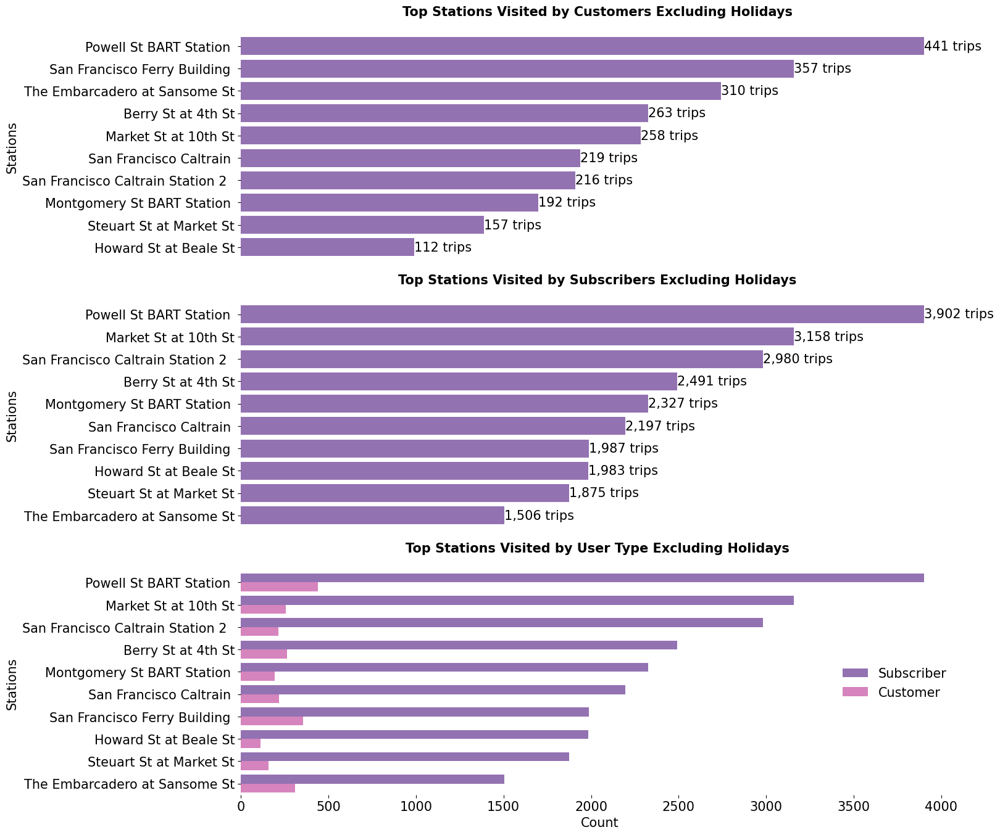

In [74]:
# Create subplots
fig, ax = plt.subplots(nrows=3, figsize=(15,16))

# Get first 10 start stations in descending order of frequency
count = no_holiday['start_station_name'].value_counts().head(10)
# Get ordered index
topstations = list(count.index[:10])

# Select only trips that occurred in the top 10 stations
top = no_holiday[no_holiday['start_station_name'].isin(topstations)]


# Select only Customers
top_stations_c = top[top['user_type'] == 'Customer'] 
count = top_stations_c['start_station_name'].value_counts().head(10)
order = count.index

# Plot horizontal bar
create_hbar(top_stations_c, 'start_station_name', order, ax[0])
ax[0].set(ylabel='Stations')
add_title('Top Stations Visited by Customers Excluding Holidays \n', ax[0])


# Select only Subscribers
top_stations_s = top[top['user_type'] == 'Subscriber'] 
count = top_stations_s['start_station_name'].value_counts().head(10)
order = count.index

# Plot horizontal bar
create_hbar(top_stations_s, 'start_station_name', order, ax[1])
ax[1].set(ylabel='Stations')
add_title('Top Stations Visited by Subscribers Excluding Holidays \n', ax[1])


# Plot both subscribers and customers in a horizontal clustered bar
create_clusteredbar(top, None, 'start_station_name', 'user_type', type_order, topstations, 'User Type', ax[2])
ax[2].legend(loc=5);
ax[2].set(xlabel='Count', ylabel='Stations')
add_title('Top Stations Visited by User Type Excluding Holidays \n', ax[2])

From the charts above, it can be seen that the Powell St BART Station is most frequented by both Customers and Subscribers.

### Talk about some of the relationships you observed in this part of the investigation. How did the feature(s) of interest vary with other features in the dataset?

I noticed that rather than showing relationships, the supporting variables show clusters and patterns which could aid in developing a profile for the types of users in user_type variable. Also Subscribers tend to take shorter trips than Customers.

### Did you observe any interesting relationships between the other features (not the main feature(s) of interest)?

There is a bit of interaction between each of the two numerical variables; 'member_age' and 'duration_mins' and the categorical variable 'bike_share_for_all_trip'. Users with the bikeshareforall membership are younger than those that are not under the progem. Regardless, all the variables of interest can aid in our investigation by highlighing key insights regarding user-type personas.

<a id='multi'></a>
### <u>Multivariate Exploration</u>
This aspect of exploration investigates the relationships among three or more variables. 

Here, I will explore how my supporting variables interact with the 'user_type' variable and see how much more specific information can be obtained to describe my main feature of interest.

In [75]:
def create_pointplt(data, x, y, ax): # Function creates a point plot on a specified axis object
    sns.pointplot(data = data, x = x, y = y, 
                  hue = 'user_type', hue_order=type_order, 
                  palette={'Subscriber':base_color, 'Customer':next_color}, 
                  dodge = 0.3, linestyles = "", errwidth=1, ax=ax
                 )
    ax.legend(loc=0, framealpha = 1, title = 'User Type')
    ax.spines[['top', 'right']].set_visible(False);

#### Comparison of User Types by Gender, Duration (mins) and Age

#### Do any noticeable trends exist in the relationship between age and gender   the different user types?

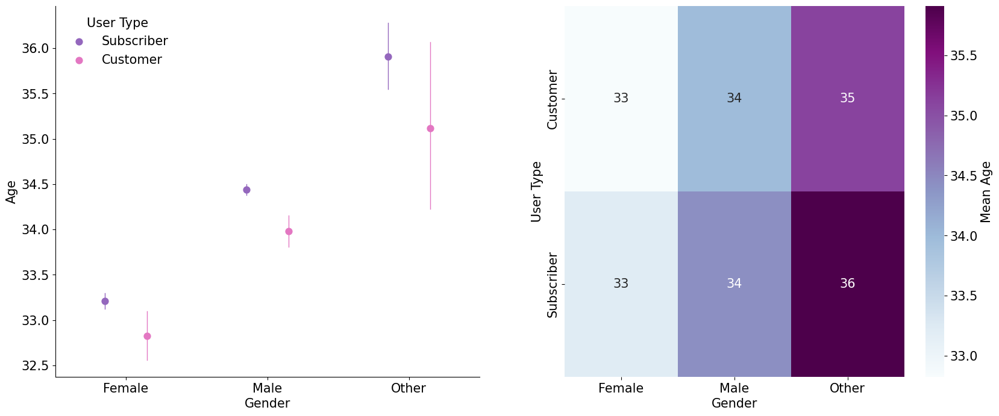

In [76]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(20,8))

# Create point plot
create_pointplt(no_holiday, 'member_gender', 'member_age', ax=ax[0])
ax[0].set(xlabel='Gender', ylabel='Age')


# Get data to plot 2d bar chart
cat_means = no_holiday.groupby(['member_gender', 'user_type']).mean()['member_age'].reset_index(name = 'member_age')
cat_means = cat_means.pivot(index = 'user_type', columns = 'member_gender',
                            values = 'member_age')

# Plot 2d bar chart
create_heat(cat_means, 'Gender', 'User Type', ax[1], 'Mean Age', vmin=None)

The mean ages of the genders appear consistent across the board, with female customers and subscribers having a mean age of 33, and male customers and subscribers having a mean age of 34. For users with the gender type 'Other', subscribers appear to be older than customers on average, but only slightly. Hence we can infer from this that generally subscribers and consumers are middle-aged.

#### Do any noticeable trends exist in the the relationship between duration and gender for the different user types?

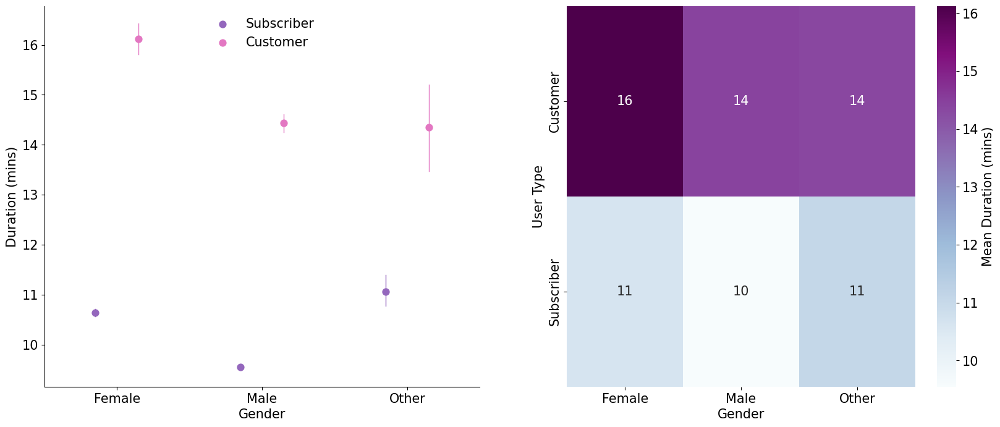

In [77]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(20,8))

# Create point plot
create_pointplt(no_holiday, 'member_gender', 'duration_mins', ax=ax[0])
ax[0].set(xlabel='Gender', ylabel='Duration (mins)')
ax[0].legend(loc=9)


# Get data to plot 2d bar chart
cat_means = no_holiday.groupby(['member_gender', 'user_type']).mean()['duration_mins'].reset_index(name = 'duration_mins')
cat_means = cat_means.pivot(index = 'user_type', columns = 'member_gender',
                            values = 'duration_mins')
# Plot 2d bar chart
create_heat(cat_means, 'Gender', 'User Type', ax[1], 'Mean Duration (mins)', vmin=None)

The mean durations of the genders shows that for all gender types, customers take longer duration trips than subscribers.

#### Comparison of User Types by Day and Duration (mins)

#### Do any noticeable trends exist in the the relationship between duration and day of week for the different user types?

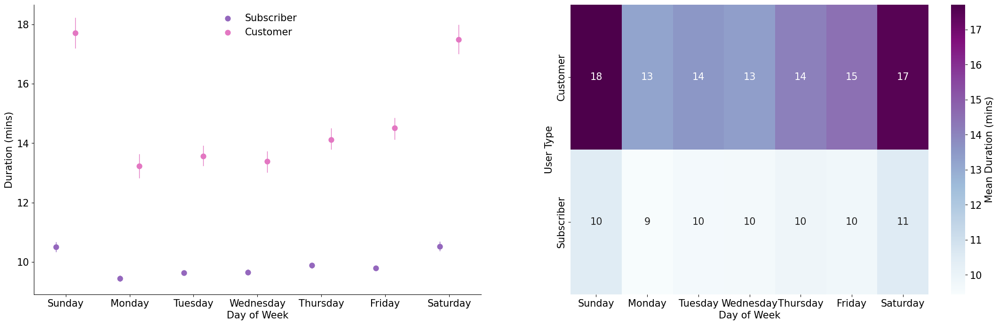

In [78]:
# Create subplots
fig, ax = plt.subplots(ncols=2, figsize=(27,8))

# Create point plot
create_pointplt(no_holiday, 'ride_day', 'duration_mins', ax=ax[0])
ax[0].set(xlabel='Day of Week', ylabel='Duration (mins)')
ax[0].legend(loc=9)


# Get data to plot 2d bar chart
cat_means = (no_holiday.groupby(['ride_day', 'user_type'])
             .mean()['duration_mins']
             .reset_index(name = 'duration_mins')
            )
cat_means = cat_means.pivot(index = 'user_type', columns = 'ride_day',
                            values = 'duration_mins')

# Plot 2d bar chart
create_heat(cat_means, 'Day of Week', 'User Type', ax[1], 'Mean Duration (mins)', vmin=None)
plt.xticks(rotation=0);

We can observe that for every day of the week, customers generally engage in longer trips than subscribers. We can also observe that customers and subscribers engage in longer trips on weekends (i.e. Saturday and Sunday) than they do on weekdays. The peak average duration for Customers is 18 minutes while that of Subscribers is 11 minutes.

#### Comparison of User Types by Hour of Day and Duration (mins) 

#### Do any noticeable trends exist in the the relationship between the duration and hour of day for the different user types?

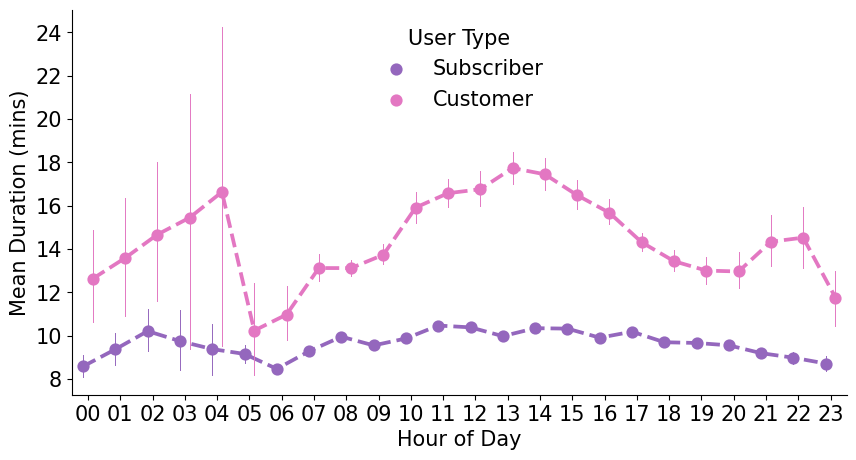

In [79]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(10,5))

# Create point plot
sns.pointplot(data = no_holiday, 
              x = 'start_hour', y = 'duration_mins', 
              hue = 'user_type', hue_order=type_order, order=hour_order,
              palette={'Subscriber':base_color, 'Customer':next_color}, 
              dodge = 0.3, linestyles = "--", errwidth=0.7, ax=ax
             )

# Format amd label plot
ax.set(xlabel='Hour of Day', ylabel='Mean Duration (mins)')
ax.legend(loc=9, framealpha = 1, title = 'User Type')
ax.spines[['top', 'right']].set_visible(False);

Similar to our observations so far, It is clear that customers generally take longer trips than subscribers. The line for customers is turbulent with different high points and low points and there's a lot of uncertainty around the mean at 4:00. From 5:00, the uncertainty reduces drastically and the duration for customers rises to a peak at 13:00 before dropping gradually till 20:00 . On the other hand, the subscriber duration for each hour of the day is relatively consistent with little to no uncertainty in the mean duration for each hour.

#### Comparison of User Types by BikeShareForAll, Duration (mins) and Age

#### Do any noticeable trends exist in the the relationship between the age and bikeshareforall for the different user types?

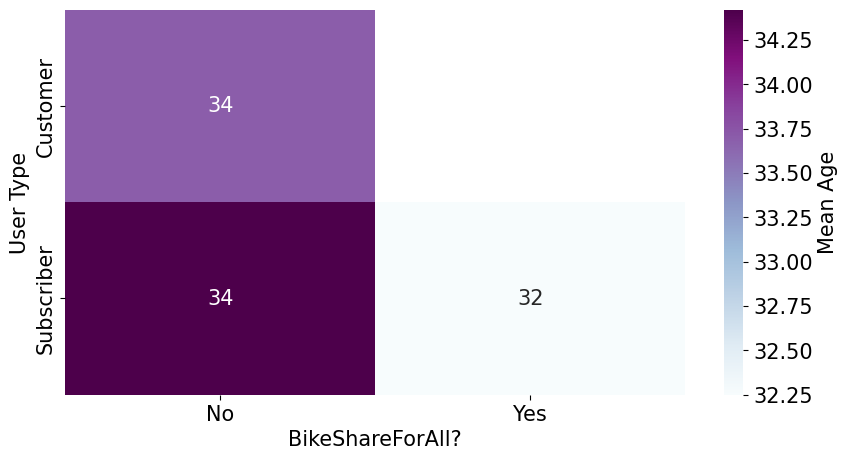

In [80]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(10,5))

# Get data to plot 2d bar chart
cat_means = (no_holiday.groupby(['bike_share_for_all_trip', 'user_type'])
             .mean()['member_age']
             .reset_index(name = 'member_age')
            )
cat_means = cat_means.pivot(index = 'user_type', columns = 'bike_share_for_all_trip',
                            values = 'member_age')

# Plot 2d bar chart
create_heat(cat_means, "BikeShareForAll?", 'User Type', ax, 'Mean Age', vmin=None)

We can see that the subscribers who are not bikeshareforall members tend to be older than those who are. 

#### Do any noticeable trends exist in the the relationship between the duration and bikeshareforall for the different user types?

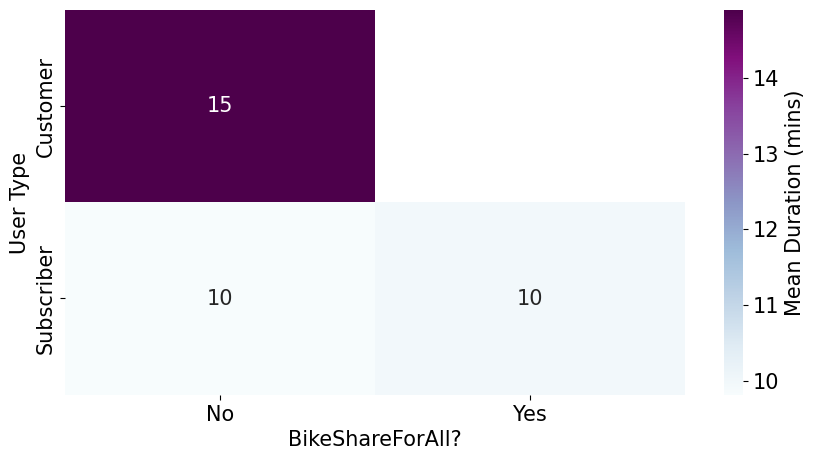

In [81]:
# Set a larger figure size for plot
fig, ax = plt.subplots(figsize=(10,5))

# Get data to plot 2d bar chart
cat_means = (no_holiday.groupby(['bike_share_for_all_trip', 'user_type'])
             .mean()['duration_mins']
             .reset_index(name = 'duration_mins')
            )
cat_means = cat_means.pivot(index = 'user_type', columns = 'bike_share_for_all_trip',
                            values = 'duration_mins')

# Plot 2d bar chart
create_heat(cat_means, 'BikeShareForAll?', 'User Type', ax, 'Mean Duration (mins)', vmin=None)

From this chart we can see indications that customers generally tend to take longer trips than subscribers. Also, the average duration of subscribers does not appear to be impacted by the bikeshareforall membership.

#### How are the top stations distributed? 

In [82]:
# Get only top stations; name, latitude and longitude
count = filtered_clean_df['start_station_name'].value_counts().head(10)
stations = count.reset_index(name='trips')
stations.rename(columns={'index':'start_station_name'}, inplace=True)
lat_lon = filtered_clean_df[['start_station_name','start_station_latitude', 'start_station_longitude', 'user_type']]
add = lat_lon.groupby('start_station_name')[['start_station_latitude', 'start_station_longitude']].first().reset_index()
top_stations = pd.merge(stations, add, on='start_station_name', how='left')

In [83]:
# Create mapbox object and plot station points
# Outer points for all stations
fig = px.scatter_mapbox(
    no_holiday,  # Our DataFrame
    lat='start_station_latitude',
    lon='start_station_longitude',
    center={"lat": 37.786375, "lon": -122.404904},  # Map will be centered on Powell St BART Station 
    width=900,  # Width of map
    height=600,  # Height of map
    zoom=7.5,
    mapbox_style="carto-positron",
    hover_name='start_station_name',
    hover_data={'start_station_latitude':False, 'start_station_longitude':False},
    title=f'<b>Distribution of Stations in San Francisco Bay Area<b>'
)

fig.update_traces(showlegend=True, legendgrouptitle=dict(text='User Type'), 
                  marker=dict(size=20, color='MediumPurple', opacity=0.1)
                 )
fig['data'][0]['name']='Stations'

# Smaller points denote top stations
fig.add_trace(go.Scattermapbox(
    lat=top_stations['start_station_latitude'],
    lon=top_stations['start_station_longitude'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color='Fuchsia',
        opacity=0.8),
    name='Top Station',
    text=top_stations['start_station_name'],
    hoverinfo='text' # Display station name when hovering mouse over point
    ))

From the map above, We observe that the stations are gathered in three clusters; one in Oakland, one in San Francisco and the last one in San Jose. Hence we can say that the stations in the San Francisco bay area consists of stations in the cities; Oakland, San Francisco and San Jose.

We can also see that the top stations which both customers and subscribers use, as obtained from the bivariate analysis section, are concentrated in San Francisco.

In [84]:
# Create mapbox object and plot station points
# Outer points for Subscribers
fig = px.scatter_mapbox(
    no_holiday,  # Our DataFrame
    lat='start_station_latitude',
    lon='start_station_longitude',
    center={"lat": 37.786375, "lon": -122.404904},  # Map will be centered on Powell St BART Station 
    width=900,  # Width of map
    height=600,  # Height of map
    zoom=12,
    mapbox_style="carto-positron",
    hover_name='start_station_name',
    hover_data={'start_station_latitude':False, 'start_station_longitude':False},
    title=f'<b>Distribution of Stations in San Francisco<b>'
)

fig.update_traces(showlegend=True, legendgrouptitle=dict(text='User Type'), 
                  marker=dict(size=20, color='MediumPurple', opacity=0.1)
                 )
fig['data'][0]['name']='Stations'

# Smaller points denote top stations
fig.add_trace(go.Scattermapbox(
    lat=top_stations['start_station_latitude'],
    lon=top_stations['start_station_longitude'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color='Fuchsia',
        opacity=0.8),
    name='Top Station',
    text=top_stations['start_station_name'],
    hoverinfo='text' # Display station name when hovering mouse over point
    ))

Upon closer inspection, the top stations are particularly concentrated in the eastern part of San Francisco.

In [85]:
# Create mapbox object and plot station points
# Create bigger point
fig = px.scatter_mapbox(
    top_stations,  # Our DataFrame
    lat='start_station_latitude',
    lon='start_station_longitude',
    center={"lat": 37.786375, "lon": -122.404904},  # Map will be centered on Powell St BART Station 
    width=900,  # Width of map
    height=600,  # Height of map
    zoom=12,
    mapbox_style="carto-positron",
    title=f'<b>Distribution of Top Stations in San Francisco Bay Area<b>'
)

fig.update_traces(marker=dict(size=20, color='Fuchsia', opacity=0.3)
                 )

station_name = list(top_stations['start_station_name'])
stations_data = {station:top_stations.query("start_station_name == '%s'" %station)
                              for station in station_name}

# Create smaller point
fig.add_trace(go.Scattermapbox(
    lat=top_stations['start_station_latitude'],
    lon=top_stations['start_station_longitude'],
    mode='markers+text',
    name="",
    customdata=top_stations['start_station_name'],
    showlegend=False,
    marker=go.scattermapbox.Marker(
        size=10,
        color='Fuchsia',
        opacity=0.5),
    text=top_stations['trips'],
    hovertemplate="<b>%{customdata}</b><br><br>" + "No. of Trips: %{text:,.0f}<br>" # Display station name when hovering mouse over point
)
             )
    
fig.show()

From the plot above, the top stations are located in the same area. The two Caltrain stations, as well as, the station at Berry St are located very close to each other. From our bivariate analysis, we saw that the Powell St BART station was the most visited station. I would've expected that the Montgomery station would be the most visited since it's basically at the center of all the other top stations but unexpectedly the Powell St BART station is the most popular. 

### Talk about some of the relationships you observed in this part of the investigation. Were there features that strengthened each other in terms of looking at your feature(s) of interest?

Comparing the types of users in the main variable of interest; user_type by the member_gender, day of week, hour of day and duration variables, the observation that customers generally took longer trips than subscribers was strengthened.

### Were there any interesting or surprising interactions between features?

The variables didn't really have much relationship with each other but they were able to help us further separate and identify the inherent feature which would help us identify each user type.

<a id='conclusions'></a>
## Conclusions
I started by exploring the dataset as a whole and looking at each feature independently. From this, I arrived at the following insights:

1. There are 2 types of users in the dataset. They include Customers and Subscribers. Subscribers are residents with annual passes and Customers are visitors with 24-hour passes or three-day passes.[(Wheretraveler.com)](https://www.wheretraveler.com/san-francisco/play/guide-bay-area-bike-share) 
2. Majority of trips were taken by Subscribers. Approximately 1 in every 10 trips, selected at random, was taken by a Customer.
3. Majority of bike users are Male. 
4. The distribution of age is skewed to the right, with a lot of users around the age range of 25 to 40. The age distribution is bimodal, with a peak between 25 and 30 and another between 30 and 35.
5. 19% of trips occurred on a Thursday. Also trips on the weekend, i.e. Saturday and Sunday, have the least frequency. 
6. Most users embarked on their trips in the afternoon within the time window of 15:00pm to 17:59pm. Also, night trips are less frequent. 
7. Majority of trips last between the duration of 4-16 minutes and longer trips are also less frequent. This is in line with the purpose of the bike share system which is for short duration trips.
8. The Powell St BART station is the most visited and most popuplar station for bike user trips. We can also see that the top 10 start stations and the top 10 end stations are the same albeit with some fluctuations in position.
9. Bikeshare for All is a subsidized membership program which makes membership accessible to low-come individuals. It includes trips up to a full hour without redocking [(Sfmta.com)](https://www.sfmta.com/blog/bikeshare-pricing-frequently-asked-questions-faq). About 10% of trips were taken by users with the bikeshare for all membership. Users wih the bikeshare for all membership took very few trips.


I then tried to explore whether there were relationships in the data through bivariate and multivariate plots. Unfortunately, there were no strong relationships. However, I observed that there were clusters and patterns when the variables were plotted against each other. This helped to identify and develop a profile/ a persona for each of the users. The following insights were gotten:

1. For both user types, Males exceed Females. 
2. The days of the week with the highest trip activity for Subscribers and Customers respectively are Tuesday and Friday. There is increased ride activity during holidays.
3. Both users mostly took trips at 8:00 (8am) and at 17:00 (5pm) in a day. The highest peak for subscribers and customers respectively is 8am and 5pm.
4. There are only Subscribers with the bikeshareforall membership. The average duration of subscribers does not appear to be impacted by the bikeshareforall membership. Also, subscribers who are not bikeshareforall members tend to be older than those who are.
5. Majority of trips for Subscribers fell between 4-10 minutes while that of Customers is 4-16 minutes.
6. Majority of trips by both Subscribers and Customers were taken by users within the age range of 25 to 35. Subscribers aged 26 and 31 made the most trips, with age 31 having the largest frequency. For Customers, majority of trips tend to be made by users aged 30.
7. The Powell St BART Station is most frequented by both Customers and Subscribers.
8. The mean ages of the genders appear consistent across the board, with female customers and subscribers having a mean age of 33, and male customers and subscribers having a mean age of 34. For users with the gender type 'Other', subscribers appear to be older than customers on average, but only slightly. Hence we can infer from this that generally subscribers and consumers are middle-aged.
9. For all gender types, customers take longer duration trips than subscribers.
10. For every day of the week, customers generally engage in longer trips than subscribers. Customers and subscribers engage in longer trips on weekends (i.e. Saturday and Sunday) than they do on weekdays. The peak average duration for Customers is 18 minutes while that of Subscribers is 11 minutes.
11. The stations in the San Francisco bay area consists of stations in the cities; Oakland, San Francisco and San Jose.
12. The top stations which both customers and subscribers use are concentrated in the eastern part of San Francisco.